In [2]:
import pandas as pd
import numpy as np

#
import seaborn as sns
import matplotlib.pyplot as plt
import plotly.express as px
import plotly.graph_objects as go
from plotly.subplots import make_subplots
#
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import LabelEncoder, StandardScaler, MinMaxScaler
from sklearn.impute import KNNImputer
from imblearn.over_sampling import SMOTE



In [3]:
# managed PC 
PATH_TEST = r'E:\_Projects\_Under Construction Projects\Credit-score-classification\test.csv'
PATH_TRAIN=r'E:\_Projects\_Under Construction Projects\Credit-score-classification\train.csv'

$ f


In [63]:
df_train = pd.read_csv(PATH_TRAIN, encoding='utf-8', sep=',')
# df_test = pd.read_csv(PATH_TEST,encoding='utf-8',sep=',')


C:\Users\hp\AppData\Local\Temp\ipykernel_11692\3712790108.py:1: DtypeWarning: Columns (26) have mixed types. Specify dtype option on import or set low_memory=False.
  df_train = pd.read_csv(PATH_TRAIN, encoding='utf-8', sep=',')


In [5]:
df_train.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 100000 entries, 0 to 99999
Data columns (total 28 columns):
 #   Column                    Non-Null Count   Dtype  
---  ------                    --------------   -----  
 0   ID                        100000 non-null  object 
 1   Customer_ID               100000 non-null  object 
 2   Month                     100000 non-null  object 
 3   Name                      90015 non-null   object 
 4   Age                       100000 non-null  object 
 5   SSN                       100000 non-null  object 
 6   Occupation                100000 non-null  object 
 7   Annual_Income             100000 non-null  object 
 8   Monthly_Inhand_Salary     84998 non-null   float64
 9   Num_Bank_Accounts         100000 non-null  int64  
 10  Num_Credit_Card           100000 non-null  int64  
 11  Interest_Rate             100000 non-null  int64  
 12  Num_of_Loan               100000 non-null  object 
 13  Type_of_Loan              88592 non-null   ob

In [6]:
df_train.describe().T

,count,mean,std,min,25%,50%,75%,max
Monthly_Inhand_Salary,84998.0,4194.170850,3183.686167,303.645417,1625.568229,3093.745000,5957.448333,15204.633333
Num_Bank_Accounts,100000.0,17.091280,117.404834,-1.000000,3.000000,6.000000,7.000000,1798.000000
Num_Credit_Card,100000.0,22.474430,129.057410,0.000000,4.000000,5.000000,7.000000,1499.000000
Interest_Rate,100000.0,72.466040,466.422621,1.000000,8.000000,13.000000,20.000000,5797.000000
Delay_from_due_date,100000.0,21.068780,14.860104,-5.000000,10.000000,18.000000,28.000000,67.000000
Num_Credit_Inquiries,98035.0,27.754251,193.177339,0.000000,3.000000,6.000000,9.000000,2597.000000
Credit_Utilization_Ratio,100000.0,32.285173,5.116875,20.000000,28.052567,32.305784,36.496663,50.000000
Total_EMI_per_month,100000.0,1403.118217,8306.041270,0.000000,30.306660,69.249473,161.224249,82331.000000


In [7]:
df_train.describe(include='object').T


,count,unique,top,freq
ID,100000,100000,0x1602,1
Customer_ID,100000,12500,CUS_0xd40,8
Month,100000,8,January,12500
Name,90015,10139,Langep,44
Age,100000,1788,38,2833
SSN,100000,12501,#F%$D@*&8,5572
Occupation,100000,16,_______,7062
Annual_Income,100000,18940,36585.12,16
Num_of_Loan,100000,434,3,14386
Type_of_Loan,88592,6260,Not Specified,1408


<AxesSubplot: >

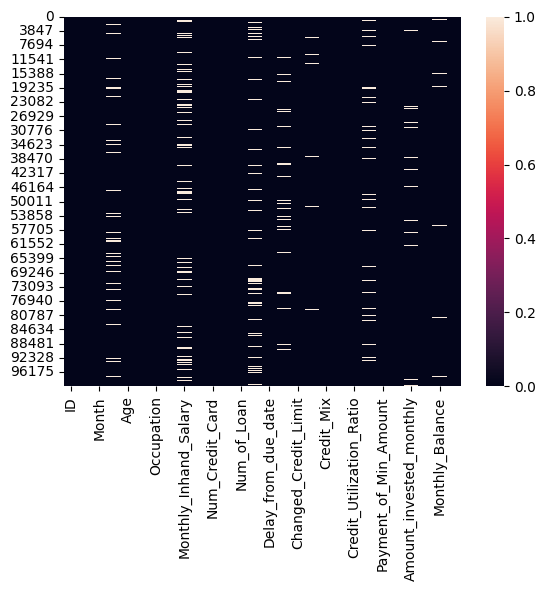

In [8]:
sns.heatmap(df_train.isnull())

# Preprocessing

In [80]:

def Remove_value(datafram, col):
    datafram[col] = [str(s).replace('_', '') for s in datafram[col]]

# convert to int


def ConvertDataType(datafram, col, dt):
    datafram[col] = datafram[col].astype(dt)


## 02.Month

In [9]:
df_train['Month'].value_counts()

Month
January     12500
February    12500
March       12500
April       12500
May         12500
June        12500
July        12500
August      12500
Name: count, dtype: int64

In [10]:
df_train['Month'].isnull().sum()

0

## 03.Name                      

In [11]:
df_train['Name'].value_counts()


Name
Langep            44
Stevex            44
Vaughanl          39
Jessicad          39
Raymondr          38
                  ..
Alina Selyukhg     4
Habboushg          4
Mortimerq          4
Ronaldf            4
Timothyl           3
Name: count, Length: 10139, dtype: int64

In [12]:
df_train['Name'].isnull().sum()

9985

In [13]:
df_train[df_train['Name'].isnull()]

,ID,Customer_ID,Month,Name,Age,SSN,Occupation,Annual_Income,Monthly_Inhand_Salary,Num_Bank_Accounts,...,Credit_Mix,Outstanding_Debt,Credit_Utilization_Ratio,Credit_History_Age,Payment_of_Min_Amount,Total_EMI_per_month,Amount_invested_monthly,Payment_Behaviour,Monthly_Balance,Credit_Score
7,0x1609,CUS_0xd40,August,NaN,23,#F%$D@*&8,Scientist,19114.12,1824.843333,3,...,Good,809.98,23.933795,NaN,No,49.574949,24.785216509052056,High_spent_Medium_value_payments,358.12416760938714,Standard
17,0x161b,CUS_0x2dbc,February,NaN,34,486-85-3974,Engineer,143162.64,12187.220000,1,...,Good,1303.01,41.702573,17 Years and 10 Months,No,246.992319,232.86038375993544,High_spent_Small_value_payments,998.8692967863226,Good
22,0x1620,CUS_0x2dbc,July,NaN,34,486-85-3974,Engineer,143162.64,12187.220000,1,...,Good,1303.01,38.068624,18 Years and 3 Months,No,246.992319,263.17416316163934,High_spent_Small_value_payments,968.5555173846187,Standard
64,0x1662,CUS_0x4157,January,NaN,23,070-19-1622,Doctor,114838.41,9843.867500,2,...,Good,1377.74,33.664554,21 Years and 4 Months,No,226.892792,215.19351594560425,High_spent_Small_value_payments,802.3004421328528,Good
80,0x167a,CUS_0xa66b,January,NaN,40,221-30-8554,Teacher,33751.27,2948.605833,5,...,Standard,1328.93,37.089076,19 Years and 2 Months,NM,65.008174,117.30669710658556,High_spent_Medium_value_payments,362.54571194023237,Standard
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
99964,0x25fba,CUS_0x372c,May,NaN,18,340-85-7301,Lawyer,42903.79,3468.315833,0,...,Good,1079.48,23.140640,28 Years and 5 Months,No,34.975457,450.6460933992599,Low_spent_Small_value_payments,151.210033,Good
99965,0x25fbb,CUS_0x372c,June,NaN,19,340-85-7301,Lawyer,42903.79,3468.315833,0,...,Good,1079.48,35.549456,28 Years and 6 Months,No,34.975457,187.3559686116327,Low_spent_Large_value_payments,394.500158,Good
99969,0x25fc3,CUS_0xf16,February,NaN,45,868-70-2218,Media_Manager,16680.35,1528.029167,1,...,Good,897.16,34.085971,21 Years and 2 Months,No,41.113561,104.64623687765652,High_spent_Small_value_payments,267.043119,Good
99973,0x25fc7,CUS_0xf16,June,NaN,45,868-70-2218,Media_Manager,16680.35,1528.029167,1,...,Good,897.16,24.972853,21 Years and 6 Months,No,41.113561,__10000__,Low_spent_Small_value_payments,233.301539,Good


In [14]:
customer_id_name =  df_train[df_train['Name'].isnull()]['Customer_ID'].values

for Cid in customer_id_name :
    realName=''
    
    # realName_list = df_train.loc[df_train['Customer_ID']== Cid]['Name'].values
    realName = df_train.loc[(df_train['Customer_ID'] == 'CUS_0x1232') & (
        df_train['Name'].notna())]['Name'].values[0]
    
    df_train.loc[(df_train['Customer_ID'] == Cid) &(df_train['Name'].isna()), ['Name']] = realName


In [ ]:
df_train[df_train['Name'].isnull()]


,ID,Customer_ID,Month,Name,Age,SSN,Occupation,Annual_Income,Monthly_Inhand_Salary,Num_Bank_Accounts,...,Credit_Mix,Outstanding_Debt,Credit_Utilization_Ratio,Credit_History_Age,Payment_of_Min_Amount,Total_EMI_per_month,Amount_invested_monthly,Payment_Behaviour,Monthly_Balance,Credit_Score


## 04.Age ??

In [4]:
df_train['Age'].isnull().sum()


0

In [5]:
# We are have values = 28_
df_train['Age'] = [s.replace('_', '') for s in df_train['Age']]

# convert to int 
df_train['Age'] = df_train['Age'].astype(int)


# we are have values = -500
Customer_ID_age = df_train[df_train['Age'] < 0]['Customer_ID'].values


In [6]:
df_train[df_train['Age'] < 0]

,ID,Customer_ID,Month,Name,Age,SSN,Occupation,Annual_Income,Monthly_Inhand_Salary,Num_Bank_Accounts,...,Credit_Mix,Outstanding_Debt,Credit_Utilization_Ratio,Credit_History_Age,Payment_of_Min_Amount,Total_EMI_per_month,Amount_invested_monthly,Payment_Behaviour,Monthly_Balance,Credit_Score
2,0x1604,CUS_0xd40,March,Aaron Maashoh,-500,821-00-0265,Scientist,19114.12,NaN,3,...,Good,809.98,28.609352,22 Years and 3 Months,No,49.574949,81.699521264648,Low_spent_Medium_value_payments,331.2098628537912,Good
113,0x16ab,CUS_0xff4,February,NaN,-500,655-05-7666,Entrepreneur,25546.26,NaN,8,...,Standard,758.44,29.711376,18 Years and 3 Months,Yes,101.328637,300.32323168069064,Low_spent_Small_value_payments,129.9336309554582,Standard
289,0x17b3,CUS_0x4080,February,ra Alperx,-500,995-37-8920,Mechanic,29469.98,2227.831667,7,...,Bad,3421.66,30.268411,13 Years and 3 Months,NM,69.685459,125.49176826031132,High_spent_Small_value_payments,287.6059398340756,Standard
340,0x17fe,CUS_0x9bc1,May,Jaisinghanij,-500,445-18-4420,Architect,20574.47,1740.539167,6,...,Standard,749.95,29.036164,11 Years and 3 Months,Yes,49.348666,139.97856227172545,Low_spent_Large_value_payments,254.72668807344257,Standard
560,0x194a,CUS_0x2827,January,Lisah,-500,486-07-1289,Scientist,144546.72,11809.560000,0,...,Good,1045.11,40.840687,22 Years and 11 Months,No,136.988557,573.4115904774258,High_spent_Small_value_payments,730.5558529037837,Standard
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
99531,0x25d31,CUS_0x85dd,April,Lucianam,-500,767-36-7303,Lawyer,8974.555,NaN,10,...,Bad,1660.14,22.173985,16 Years and 6 Months,Yes,30.443262,27.83822717284169,Low_spent_Medium_value_payments,300.106469,Poor
99541,0x25d3f,CUS_0xc22f,June,McMillanw,-500,795-34-9348,Scientist,34671.15,2637.262500,4,...,Standard,1071.97,25.076571,21 Years and 8 Months,Yes,52.337589,104.78314244377886,High_spent_Small_value_payments,366.605518,Standard
99762,0x25e8c,CUS_0x1b07,March,Baldwinq,-500,739-15-8297,Accountant,17818.6,1659.883333,4,...,Standard,301.52,26.398987,18 Years and 5 Months,NM,11.581102,34.98032691383901,High_spent_Medium_value_payments,369.426905,Standard
99937,0x25f93,CUS_0xad4f,February,Sabina Zawadzkig,-500,226-45-0652,_______,22620.79,1722.065833,7,...,Standard,642.46,31.841872,NaN,No,0.000000,105.07629339039072,Low_spent_Large_value_payments,337.13029,Standard


In [ ]:
df_train[df_train['Customer_ID'] == 'CUS_0xad4f']['Age'].drop_duplicates().values


array([47, 48])

In [7]:
for Cid in Customer_ID_age :
    realAge = df_train[df_train['Customer_ID'] ==Cid]['Age'].drop_duplicates().values[0]
    if realAge == -500 :
        realAge = df_train[df_train['Customer_ID'] ==Cid]['Age'].drop_duplicates().values[1]
    
    df_train.loc[(df_train['Customer_ID'] == Cid) & (df_train['Age']== -500), ['Age']] = realAge



In [14]:
Customer_IDs = df_train[(df_train['Age'] < 0) | (
    df_train['Age'] > 60)]['Customer_ID'].values

for Cid in Customer_IDs:
    realAge = df_train[df_train['Customer_ID'] ==
                       Cid]['Age'].drop_duplicates().values[0]
    if realAge < 0 or realAge > 60:
        realAge = df_train[df_train['Customer_ID'] ==
                           Cid]['Age'].drop_duplicates().values[1]

    df_train.loc[(df_train['Customer_ID'] == Cid) & (
        (df_train['Age'] < 0) | (df_train['Age'] > 60)), ['Age']] = realAge


In [15]:
fig = px.box(df_train, y="Age")
fig.show()


In [16]:

df_train[df_train['Age'] > 60]


,ID,Customer_ID,Month,Name,Age,SSN,Occupation,Annual_Income,Monthly_Inhand_Salary,Num_Bank_Accounts,...,Credit_Mix,Outstanding_Debt,Credit_Utilization_Ratio,Credit_History_Age,Payment_of_Min_Amount,Total_EMI_per_month,Amount_invested_monthly,Payment_Behaviour,Monthly_Balance,Credit_Score


In [13]:
df_train[df_train['Customer_ID']=='CUS_0x5407']['Age']

56    7580
57      30
58      30
59      30
60      30
61      30
62      30
63      30
Name: Age, dtype: int32

## 05.SSN

In [ ]:
df_train['SSN'].value_counts()

SSN
#F%$D@*&8      5572
078-73-5990       8
486-78-3816       8
750-67-7525       8
903-50-0305       8
               ... 
856-06-6147       4
753-72-2651       4
331-28-1921       4
604-62-6133       4
286-44-9634       4
Name: count, Length: 12501, dtype: int64

In [ ]:
df_train[df_train['SSN']=='#F%$D@*&8']

,ID,Customer_ID,Month,Name,Age,SSN,Occupation,Annual_Income,Monthly_Inhand_Salary,Num_Bank_Accounts,...,Credit_Mix,Outstanding_Debt,Credit_Utilization_Ratio,Credit_History_Age,Payment_of_Min_Amount,Total_EMI_per_month,Amount_invested_monthly,Payment_Behaviour,Monthly_Balance,Credit_Score
7,0x1609,CUS_0xd40,August,Aaron Maashoh,23,#F%$D@*&8,Scientist,19114.12,1824.843333,3,...,Good,809.98,23.933795,NaN,No,49.574949,24.785216509052056,High_spent_Medium_value_payments,358.12416760938714,Standard
29,0x162b,CUS_0xb891,June,Jasond,55,#F%$D@*&8,_______,30689.89,2612.490833,2,...,_,632.46,27.445422,17 Years and 8 Months,No,16.415452,84.95284817115969,High_spent_Small_value_payments,419.8807835023488,Standard
51,0x164d,CUS_0x284a,April,Nadiaq,34,#F%$D@*&8,Lawyer,131313.4,10469.207759,0,...,Good,352.16,42.645785,30 Years and 10 Months,No,23834.000000,337.43495631738324,High_spent_Medium_value_payments,899.1987716145285,Good
54,0x1650,CUS_0x284a,July,Nadiaq,34,#F%$D@*&8,Lawyer,10909427.0,NaN,0,...,Good,352.16,26.947565,31 Years and 1 Months,No,911.220179,930.3918977796665,!@9#%8,326.24183015224526,Good
98,0x1694,CUS_0x3e45,March,Harriet McLeodd,35,#F%$D@*&8,Entrepreneur,54392.16_,NaN,6,...,_,179.22,31.258928,27 Years and 0 Months,NM,124.392082,33.349568589344514,High_spent_Large_value_payments,558.9263489897351,Standard
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
99914,0x25f70,CUS_0x1619,March,Phil Wahbao,54,#F%$D@*&8,Media_Manager,20059.98,1523.665000,8,...,Good,909.01,29.204711,16 Years and 5 Months,No,45.076827,111.56713873012444,Low_spent_Large_value_payments,265.722534,Poor
99942,0x25f98,CUS_0xad4f,July,Sabina Zawadzkig,48,#F%$D@*&8,Developer,22620.79,1722.065833,6,...,Standard,642.46,24.714779,29 Years and 9 Months,No,0.000000,16.53218878920387,High_spent_Large_value_payments,395.674395,Poor
99946,0x25fa0,CUS_0x51b3,March,Ryana,33,#F%$D@*&8,Media_Manager,59146.36,4908.863333,2,...,Good,418.03,35.750925,20 Years and 3 Months,No,26.778419,188.54469705568923,High_spent_Medium_value_payments,525.563217,Standard
99968,0x25fc2,CUS_0xf16,January,Maria Sheahanb,44,#F%$D@*&8,Media_Manager,16680.35,1528.029167,1,...,Good,897.16,39.868572,NaN,NM,41.113561,52.95197781627658,High_spent_Small_value_payments,318.737378,Good


In [ ]:
df_train[df_train['Customer_ID'] == 'CUS_0x51b3' ]['SSN']


99944    837-85-9800
99945    837-85-9800
99946      #F%$D@*&8
99947    837-85-9800
99948    837-85-9800
99949    837-85-9800
99950    837-85-9800
99951    837-85-9800
Name: SSN, dtype: object

In [ ]:
Customer_ID_SSN= df_train[df_train['SSN']=='#F%$D@*&8']['Customer_ID'].values
Customer_ID_SSN


array(['CUS_0xd40', 'CUS_0xb891', 'CUS_0x284a', ..., 'CUS_0x51b3',
       'CUS_0xf16', 'CUS_0x8600'], dtype=object)

In [ ]:
df_train[df_train['Customer_ID'] == 'CUS_0x51b3']['SSN'].drop_duplicates().values


array(['837-85-9800', '#F%$D@*&8'], dtype=object)

In [ ]:
for Cid in Customer_ID_SSN :
    realSSN = df_train[df_train['Customer_ID'] ==Cid]['SSN'].drop_duplicates().values[0]
    if realSSN == '#F%$D@*&8' :
        realSSN = df_train[df_train['Customer_ID'] ==Cid]['SSN'].drop_duplicates().values[1]

    df_train.loc[(df_train['Customer_ID'] == Cid) & (
        df_train['SSN'] == '#F%$D@*&8'), ['SSN']] = realSSN


In [ ]:
df_train[df_train['SSN'] == '#F%$D@*&8']


,ID,Customer_ID,Month,Name,Age,SSN,Occupation,Annual_Income,Monthly_Inhand_Salary,Num_Bank_Accounts,...,Credit_Mix,Outstanding_Debt,Credit_Utilization_Ratio,Credit_History_Age,Payment_of_Min_Amount,Total_EMI_per_month,Amount_invested_monthly,Payment_Behaviour,Monthly_Balance,Credit_Score


## 06.Occupation

In [ ]:
df_train['Occupation'].value_counts()

Occupation
_______          7062
Lawyer           6575
Architect        6355
Engineer         6350
Scientist        6299
Mechanic         6291
Accountant       6271
Developer        6235
Media_Manager    6232
Teacher          6215
Entrepreneur     6174
Doctor           6087
Journalist       6085
Manager          5973
Musician         5911
Writer           5885
Name: count, dtype: int64

In [ ]:
df_train['Occupation'].isnull().sum()

0

In [ ]:
df_train[df_train['Occupation'] == '_______']


,ID,Customer_ID,Month,Name,Age,SSN,Occupation,Annual_Income,Monthly_Inhand_Salary,Num_Bank_Accounts,...,Credit_Mix,Outstanding_Debt,Credit_Utilization_Ratio,Credit_History_Age,Payment_of_Min_Amount,Total_EMI_per_month,Amount_invested_monthly,Payment_Behaviour,Monthly_Balance,Credit_Score
8,0x160e,CUS_0x21b1,January,Rick Rothackerj,28,004-07-5839,_______,34847.84,3037.986667,2,...,Good,605.03,24.464031,26 Years and 7 Months,No,18.816215,104.291825168246,Low_spent_Small_value_payments,470.69062692529184,Standard
16,0x161a,CUS_0x2dbc,January,Langep,34,486-85-3974,_______,143162.64,12187.220000,1,...,Good,1303.01,28.616735,17 Years and 9 Months,No,246.992319,168.413702679309,!@9#%8,1043.3159778669492,Good
18,0x161c,CUS_0x2dbc,March,Langep,34,486-85-3974,_______,143162.64,NaN,1,...,Good,1303.01,26.519815,17 Years and 11 Months,No,246.992319,__10000__,High_spent_Small_value_payments,715.741367403555,Good
20,0x161e,CUS_0x2dbc,May,Langep,34,486-85-3974,_______,143162.64,12187.220000,1,...,Good,1303.01,31.376150,18 Years and 1 Months,No,246.992319,430.9475278803298,Low_spent_Large_value_payments,810.7821526659284,Good
29,0x162b,CUS_0xb891,June,Jasond,55,072-31-6145,_______,30689.89,2612.490833,2,...,_,632.46,27.445422,17 Years and 8 Months,No,16.415452,84.95284817115969,High_spent_Small_value_payments,419.8807835023488,Standard
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
99920,0x25f7a,CUS_0x2654,January,enj,37,647-67-8889,_______,139664.96,11777.746667,3,...,_,365.66,31.043048,29 Years and 7 Months,Yes,423.731016,282.78234595777644,High_spent_Large_value_payments,711.261305,Standard
99935,0x25f8d,CUS_0xb11c,August,Yinka Adegokej,38,546-94-4789,_______,15319.65,1460.637500,6,...,Bad,1453.61,34.557510,11 Years and 4 Months,Yes,28.182033,191.87777851803025,Low_spent_Small_value_payments,216.003938,Poor
99937,0x25f93,CUS_0xad4f,February,Sabina Zawadzkig,47,226-45-0652,_______,22620.79,1722.065833,7,...,Standard,642.46,31.841872,NaN,No,0.000000,105.07629339039072,Low_spent_Large_value_payments,337.13029,Standard
99943,0x25f99,CUS_0xad4f,August,Sabina Zawadzkig,48,226-45-0652,_______,22620.79,NaN,6,...,_,642.46,34.026427,29 Years and 10 Months,No,0.000000,205.21728040016708,Low_spent_Small_value_payments,256.989303,Poor


In [ ]:
df_train[df_train['Customer_ID']=='CUS_0x21b1']['Occupation'].drop_duplicates().values

array(['_______', 'Teacher'], dtype=object)

In [ ]:
Customer_ID_Occupation = df_train[df_train['Occupation'] == '_______']['Customer_ID'].values
Customer_ID_Occupation


array(['CUS_0x21b1', 'CUS_0x2dbc', 'CUS_0x2dbc', ..., 'CUS_0xad4f',
       'CUS_0xad4f', 'CUS_0x8600'], dtype=object)

In [ ]:
for Cid in Customer_ID_Occupation:
    realOcc = df_train[df_train['Customer_ID'] ==Cid]['Occupation'].drop_duplicates().values[0]
    if realOcc == '_______':
        realOcc = df_train[df_train['Customer_ID'] == Cid]['Occupation'].drop_duplicates().values[1]

    df_train.loc[(df_train['Customer_ID'] == Cid) & (
        df_train['Occupation'] == '_______'), ['Occupation']] = realOcc


In [ ]:
df_train[df_train['Occupation'] == '_______']


,ID,Customer_ID,Month,Name,Age,SSN,Occupation,Annual_Income,Monthly_Inhand_Salary,Num_Bank_Accounts,...,Credit_Mix,Outstanding_Debt,Credit_Utilization_Ratio,Credit_History_Age,Payment_of_Min_Amount,Total_EMI_per_month,Amount_invested_monthly,Payment_Behaviour,Monthly_Balance,Credit_Score


## 07.Annual_Income ??

**-

In [17]:
df_train['Annual_Income'].value_counts()

Annual_Income
36585.12     16
20867.67     16
17273.83     16
9141.63      15
33029.66     15
             ..
20269.93_     1
15157.25_     1
44955.64_     1
76650.12_     1
4262933.0     1
Name: count, Length: 18940, dtype: int64

In [18]:
# We are have values = 280.60_
df_train['Annual_Income'] = [s.replace('_', '')for s in df_train['Annual_Income']]

# convert to float 
df_train['Annual_Income'] = df_train['Annual_Income'].astype('Float64')


In [19]:
df_train['Annual_Income'].value_counts()


Annual_Income
17816.75      16
22434.16      16
40341.16      16
17273.83      16
109945.32     16
              ..
17079092.0     1
1910572.0      1
20179076.0     1
7980216.0      1
8299495.0      1
Name: count, Length: 13487, dtype: Int64

In [20]:
df_train[df_train['Customer_ID']=='CUS_0xb1a0']

# 15823.87 != 24188807.0


,ID,Customer_ID,Month,Name,Age,SSN,Occupation,Annual_Income,Monthly_Inhand_Salary,Num_Bank_Accounts,...,Credit_Mix,Outstanding_Debt,Credit_Utilization_Ratio,Credit_History_Age,Payment_of_Min_Amount,Total_EMI_per_month,Amount_invested_monthly,Payment_Behaviour,Monthly_Balance,Credit_Score
7808,0x43c2,CUS_0xb1a0,January,Wachtelm,16,249-90-4145,Lawyer,15823.87,1067.655833,8,...,Bad,3703.96,25.588341,9 Years and 7 Months,NM,87.323423,99.07399074310513,Low_spent_Medium_value_payments,200.3681694156384,Standard
7809,0x43c3,CUS_0xb1a0,February,Wachtelm,16,249-90-4145,Lawyer,15823.87,1067.655833,8,...,Bad,3703.96,36.078312,9 Years and 8 Months,Yes,87.323423,105.70751659030519,Low_spent_Medium_value_payments,193.73464356843837,Standard
7810,0x43c4,CUS_0xb1a0,March,Wachtelm,17,249-90-4145,Lawyer,15823.87,1067.655833,8,...,Bad,3703.96,39.254236,9 Years and 9 Months,Yes,87.323423,88.56711986006992,Low_spent_Small_value_payments,220.87504029867364,Standard
7811,0x43c5,CUS_0xb1a0,April,Wachtelm,17,249-90-4145,Lawyer,15823.87,1067.655833,8,...,Bad,3703.96,24.737620,NaN,Yes,87.323423,24.37781398055323,High_spent_Small_value_payments,255.0643461781903,Standard
7812,0x43c6,CUS_0xb1a0,May,Wachtelm,17,249-90-4145,Lawyer,15823.87,1067.655833,8,...,Bad,3703.96,25.288201,9 Years and 11 Months,Yes,87.323423,72.25827418609045,Low_spent_Small_value_payments,237.18388597265312,Standard
7813,0x43c7,CUS_0xb1a0,June,Wachtelm,17,249-90-4145,Lawyer,15823.87,1067.655833,8,...,_,3703.96,29.886193,10 Years and 0 Months,Yes,87.323423,119.8260358744297,Low_spent_Small_value_payments,189.61612428431386,Standard
7814,0x43c8,CUS_0xb1a0,July,NaN,17,249-90-4145,Lawyer,24188807.0,1067.655833,8,...,_,3703.96,41.268945,10 Years and 1 Months,NM,87.323423,25.385696011834174,High_spent_Small_value_payments,254.05646414690938,Standard
7815,0x43c9,CUS_0xb1a0,August,Wachtelm,17,249-90-4145,Lawyer,15823.87,1067.655833,8,...,Bad,3703.96,25.124653,10 Years and 2 Months,Yes,87.323423,100.44800015346165,Low_spent_Small_value_payments,208.9941600052819,Standard


In [21]:
fig = px.box(df_train, y="Annual_Income")
fig.show()


In [22]:
df_train[df_train['Annual_Income'] > 153000]

,ID,Customer_ID,Month,Name,Age,SSN,Occupation,Annual_Income,Monthly_Inhand_Salary,Num_Bank_Accounts,...,Credit_Mix,Outstanding_Debt,Credit_Utilization_Ratio,Credit_History_Age,Payment_of_Min_Amount,Total_EMI_per_month,Amount_invested_monthly,Payment_Behaviour,Monthly_Balance,Credit_Score
54,0x1650,CUS_0x284a,July,Nadiaq,34,#F%$D@*&8,Lawyer,10909427.0,NaN,0,...,Good,352.16,26.947565,31 Years and 1 Months,No,911.220179,930.3918977796665,!@9#%8,326.24183015224526,Good
231,0x1759,CUS_0xbffe,August,Dhanya Skariachano,40,311-13-7309,Architect,6515990.0,2210.032500,6,...,Standard,400.07,23.177617,30 Years and 10 Months,Yes,69.602920,51.83085897154975,High_spent_Large_value_payments,339.5694705464602,Standard
245,0x176f,CUS_0x9a71,June,NaN,55,889-07-2357,Scientist,586359.0,1684.168333,1,...,Good,413.32,28.836349,18 Years and 8 Months,No,29.534584,68.95672493704708,High_spent_Medium_value_payments,319.9255246757902,Good
361,0x181f,CUS_0x8e9b,February,Rachelle Younglaic,15,925-51-5335,Entrepreneur,18334118.0,4369.482500,10,...,Bad,3422.49,36.729939,10 Years and 6 Months,Yes,314.901785,124.54147043620928,High_spent_Small_value_payments,257.50499429610903,Standard
368,0x182a,CUS_0x609d,January,NaN,27,911-47-6879,Architect,19717385.0,1057.435833,7,...,Bad,2797.17_,25.314339,13 Years and 11 Months,Yes,58.868441,60.55078556335062,High_spent_Small_value_payments,246.32435693137433,Standard
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
99664,0x25dfa,CUS_0xb09,January,Lianau,31,228-47-4867,Lawyer,5794377.0,NaN,5,...,Good,928.28,38.616320,NaN,No,72.250125,169.35659164159352,High_spent_Large_value_payments,1210.84895,Standard
99714,0x25e44,CUS_0xadbd,March,Scotts,26,864-24-3672,Doctor,11712577.0,NaN,5,...,_,82.15,30.711678,23 Years and 1 Months,No,113.833391,121.49249986037856,Low_spent_Small_value_payments,334.657193,Standard
99721,0x25e4f,CUS_0x11c7,February,raden Reddallh,53,646-19-1493,Architect,8544730.0,3198.161667,5,...,Good,1019.46,26.702382,16 Years and 8 Months,No,86.809918,117.83868153104905,High_spent_Medium_value_payments,365.167567,Standard
99882,0x25f40,CUS_0x47fa,March,Yantoultra Nguif,31,291-51-7240,Mechanic,16884797.0,5440.945000,7,...,Standard,330.6,38.524095,23 Years and 0 Months,Yes,0.000000,__10000__,High_spent_Small_value_payments,536.34292,Standard


In [23]:

df_train[df_train['Customer_ID'] == 'CUS_0x284a']['Annual_Income']


48      131313.4
49      131313.4
50      131313.4
51      131313.4
52      131313.4
53      131313.4
54    10909427.0
55      131313.4
Name: Annual_Income, dtype: Float64

In [ ]:
df_train[df_train['Customer_ID'] == 'CUS_0xb1a0']['Annual_Income'].min(
)== df_train[df_train['Customer_ID'] == 'CUS_0xb1a0']['Annual_Income'].max()


False

In [34]:
df_train[df_train['Customer_ID'] == 'CUS_0xb1a0']['Annual_Income'].drop_duplicates().min()
# df_train[df_train['Annual_Income'] > 153000]


15823.87

In [ ]:
[df_train[df_train['Customer_ID'] == 'CUS_0xb1a0']
    ['Annual_Income'].values].count(15823.87)


1

In [35]:
Customer_IDs =df_train[df_train['Annual_Income'] > 153000]['Customer_ID'].values


for id in  Customer_IDs:
    realIncome = df_train[df_train['Customer_ID'] == id]['Annual_Income'].drop_duplicates().min()
    # if realIncome > 153000 :
    #     realIncome = df_train[df_train['Customer_ID'] == id]['Annual_Income'].drop_duplicates().values[-1]

    df_train.loc[(df_train['Customer_ID'] == id) & (
        df_train['Annual_Income'] > 153000), ['Annual_Income']]=realIncome
    

In [36]:
fig = px.box(df_train, y="Annual_Income")
fig.show()


In [37]:
df_train[df_train['Annual_Income'] > 153000]


,ID,Customer_ID,Month,Name,Age,SSN,Occupation,Annual_Income,Monthly_Inhand_Salary,Num_Bank_Accounts,...,Credit_Mix,Outstanding_Debt,Credit_Utilization_Ratio,Credit_History_Age,Payment_of_Min_Amount,Total_EMI_per_month,Amount_invested_monthly,Payment_Behaviour,Monthly_Balance,Credit_Score
1728,0x2022,CUS_0x2c31,January,Yokog,30,680-06-0631,Musician,173196.32,14258.026667,4,...,Good,967.23,37.228795,28 Years and 5 Months,No,107.8109,366.6186097928724,High_spent_Large_value_payments,1191.3731572260067,Good
1729,0x2023,CUS_0x2c31,February,Yokog,30,680-06-0631,Musician,173196.32,14258.026667,4,...,Good,967.23,34.109317,28 Years and 6 Months,No,107.8109,459.5756330225029,High_spent_Medium_value_payments,1108.4161339963762,Good
1730,0x2024,CUS_0x2c31,March,Yokog,30,680-06-0631,Musician,173196.32,14258.026667,4,...,Good,967.23,40.809043,28 Years and 7 Months,No,107.8109,283.69135327805964,High_spent_Medium_value_payments,1284.3004137408193,Good
1731,0x2025,CUS_0x2c31,April,Yokog,30,680-06-0631,Musician,173196.32,14258.026667,4,...,Good,967.23,38.556001,28 Years and 8 Months,No,107.8109,138.67372021620406,High_spent_Large_value_payments,1419.3180468026749,Good
1732,0x2026,CUS_0x2c31,May,Yokog,30,680-06-0631,Musician,173196.32,14258.026667,4,...,Good,967.23,32.884290,28 Years and 9 Months,No,107.8109,368.0826932022325,High_spent_Small_value_payments,1209.9090738166465,Good
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
98931,0x259ad,CUS_0x1f97,April,Hitoshio,49,346-14-6418,Journalist,175718.64,14707.220000,3,...,Good,1336.86,30.083109,23 Years and 1 Months,No,0.0000,484.21248090688425,Low_spent_Medium_value_payments,1266.509519,Good
98932,0x259ae,CUS_0x1f97,May,NaN,49,346-14-6418,Journalist,175718.64,14707.220000,3,...,Good,1336.86,42.274621,23 Years and 2 Months,NM,0.0000,749.2575696912762,High_spent_Small_value_payments,981.46443,Good
98933,0x259af,CUS_0x1f97,June,Hitoshio,49,346-14-6418,Journalist,175718.64,14707.220000,3,...,Good,1336.86,32.271291,23 Years and 3 Months,No,0.0000,666.3568280953785,Low_spent_Large_value_payments,1074.365172,Good
98934,0x259b0,CUS_0x1f97,July,Hitoshio,49,346-14-6418,Journalist,175718.64,14707.220000,3,...,Good,1336.86,31.552119,23 Years and 4 Months,No,0.0000,637.7488992037422,Low_spent_Medium_value_payments,1112.973101,Good


In [32]:
df_train[df_train['Customer_ID']=='CUS_0x2c31']['Annual_Income']

1728    173196.32
1729    173196.32
1730    173196.32
1731    173196.32
1732    173196.32
1733    173196.32
1734    173196.32
1735    173196.32
Name: Annual_Income, dtype: Float64

In [ ]:
# هنسيبها لبكره . بص الفكره عايزين نشوف الرقم ده اتكرر كام مره ولو اقل من  عدد الليست يبقي في رقم غلط موجود مفروض نعدله

## 08.Monthly_Inhand_Salary ??

5rban

In [ ]:
df_train['Monthly_Inhand_Salary'].value_counts()

Monthly_Inhand_Salary
6769.130000    15
6358.956667    15
2295.058333    15
6082.187500    15
3080.555000    14
               ..
1087.546445     1
3189.212103     1
5640.117744     1
7727.560450     1
2443.654131     1
Name: count, Length: 13235, dtype: int64

In [ ]:
df_train['Monthly_Inhand_Salary'].isnull().sum()

15002

In [63]:
df_train[df_train['Monthly_Inhand_Salary']==0.0]


,ID,Customer_ID,Month,Name,Age,SSN,Occupation,Annual_Income,Monthly_Inhand_Salary,Num_Bank_Accounts,...,Credit_Mix,Outstanding_Debt,Credit_Utilization_Ratio,Credit_History_Age,Payment_of_Min_Amount,Total_EMI_per_month,Amount_invested_monthly,Payment_Behaviour,Monthly_Balance,Credit_Score
1,0x1603,CUS_0xd40,February,Aaron Maashoh,23,821-00-0265,Scientist,19114.12,0.0,3,...,Good,809.98,31.944960,NaN,No,49.574949,118.28022162236736,Low_spent_Large_value_payments,284.62916249607184,Good
2,0x1604,CUS_0xd40,March,Aaron Maashoh,23,821-00-0265,Scientist,19114.12,0.0,3,...,Good,809.98,28.609352,22 Years and 3 Months,No,49.574949,81.699521264648,Low_spent_Medium_value_payments,331.2098628537912,Good
3,0x1605,CUS_0xd40,April,Aaron Maashoh,23,821-00-0265,Scientist,19114.12,0.0,3,...,Good,809.98,31.377862,22 Years and 4 Months,No,49.574949,199.4580743910713,Low_spent_Small_value_payments,223.45130972736786,Good
5,0x1607,CUS_0xd40,June,Aaron Maashoh,23,821-00-0265,Scientist,19114.12,0.0,3,...,Good,809.98,27.262259,22 Years and 6 Months,No,49.574949,62.430172331195294,!@9#%8,340.4792117872438,Good
11,0x1611,CUS_0x21b1,April,Rick Rothackerj,28,004-07-5839,Teacher,34847.84,0.0,2,...,Good,605.03,39.182656,26 Years and 10 Months,No,18.816215,99.30622796053305,Low_spent_Medium_value_payments,465.6762241330048,Good
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
99944,0x25f9e,CUS_0x51b3,January,Ryana,33,837-85-9800,Media_Manager,59146.36,0.0,2,...,_,418.03,34.720661,NaN,No,26.778419,606.4365424304076,Low_spent_Small_value_payments,147.671372,Standard
99955,0x25fad,CUS_0x2084,April,Ryanl,21,253-72-7758,Architect,38321.39,0.0,4,...,Good,678.57,35.455305,17 Years and 2 Months,No,362.072453,293.71319332766717,Low_spent_Large_value_payments,197.460577,Standard
99963,0x25fb9,CUS_0x372c,April,Lucia Mutikanik,18,340-85-7301,Lawyer,42903.79,0.0,0,...,Good,1079.48,30.625298,NaN,No,34.975457,31.19391926667726,High_spent_Large_value_payments,520.662207,Standard
99975,0x25fc9,CUS_0xf16,August,Maria Sheahanb,45,868-70-2218,Media_Manager,16680.35,0.0,1,...,Good,897.16,41.212367,NaN,No,41.113561,70.8055497847255,Low_spent_Large_value_payments,310.883806,Good


In [41]:
df_train[df_train['Monthly_Inhand_Salary'] > 13000]['Customer_ID'].drop_duplicates()


1728     CUS_0x2c31
2352     CUS_0x9167
2544     CUS_0x56d1
2928     CUS_0x6065
3089     CUS_0xc23d
            ...    
98089    CUS_0x4a02
98258    CUS_0x7dc5
98488     CUS_0x6e9
98664    CUS_0x797a
98928    CUS_0x1f97
Name: Customer_ID, Length: 210, dtype: object

In [ ]:
px.box(df_train,y='Monthly_Inhand_Salary')

In [47]:
df_train[df_train['Customer_ID']=='CUS_0x1f97']['Monthly_Inhand_Salary']

98928    14707.22
98929    14707.22
98930    14707.22
98931    14707.22
98932    14707.22
98933    14707.22
98934    14707.22
98935    14707.22
Name: Monthly_Inhand_Salary, dtype: float64

In [61]:
df_train['Monthly_Inhand_Salary'].replace(np.nan,0.0,inplace=True)

In [70]:
df_train[df_train['Customer_ID'] =='CUS_0xd40']['Monthly_Inhand_Salary'].drop_duplicates().sort_values().values[-1]


1824.8433333333328

In [ ]:
Customer_ID_MIS = df_train[df_train['Monthly_Inhand_Salary'].isna()]['Customer_ID'].values
Customer_ID_MIS


array(['CUS_0xd40', 'CUS_0xd40', 'CUS_0xd40', ..., 'CUS_0x372c',
       'CUS_0xf16', 'CUS_0xaf61'], dtype=object)

In [ ]:
l = df_train[df_train['Customer_ID'] ==
             'CUS_0x5407']['Monthly_Inhand_Salary'].drop_duplicates().values[0]

l


nan

In [ ]:
for Cid in Customer_ID_MIS:
    realMis = df_train[df_train['Customer_ID'] == Cid]['Monthly_Inhand_Salary'].drop_duplicates().values[0]
    if realMis == l :
        realMis = df_train[df_train['Customer_ID'] == Cid]['Monthly_Inhand_Salary'].drop_duplicates().values[1]

    df_train.loc[(df_train['Customer_ID'] == Cid) & (df_train['Monthly_Inhand_Salary'].isna()), ['Monthly_Inhand_Salary']] = realMis


IndexError: index 1 is out of bounds for axis 0 with size 1

In [ ]:
df_train[df_train['Monthly_Inhand_Salary'].isna()]


,ID,Customer_ID,Month,Name,Age,SSN,Occupation,Annual_Income,Monthly_Inhand_Salary,Num_Bank_Accounts,...,Credit_Mix,Outstanding_Debt,Credit_Utilization_Ratio,Credit_History_Age,Payment_of_Min_Amount,Total_EMI_per_month,Amount_invested_monthly,Payment_Behaviour,Monthly_Balance,Credit_Score
40,0x163e,CUS_0x95ee,January,Np,31,612-70-8987,Lawyer,73928.46,NaN,4,...,Good,548.2,39.962685,NaN,No,15015.000000,98.67440994166124,High_spent_Large_value_payments,740.1960900583389,Good
56,0x1656,CUS_0x5407,January,Annk,7580,500-92-6408,Media_Manager,34081.38,NaN,8,...,Standard,1704.18,24.448063,NaN,NM,70.478333,162.4410091967751,Low_spent_Large_value_payments,298.19215813115227,Poor
58,0x1658,CUS_0x5407,March,Annk,30,500-92-6408,Media_Manager,34081.38,NaN,8,...,Standard,1704.18,35.111552,14 Years and 9 Months,Yes,70.478333,199.7207654954979,Low_spent_Large_value_payments,260.9124018324295,Poor
62,0x165c,CUS_0x5407,July,Annk,30,500-92-6408,Media_Manager,34081.38,NaN,8,...,Standard,1704.18,38.438505,15 Years and 1 Months,NM,70.478333,55.45978063925893,High_spent_Small_value_payments,395.17338668866836,Standard
104,0x169e,CUS_0x6c66,January,Sinead Carews,39,328-33-6328,Manager,8701.545,NaN,6,...,_,2602.69,24.523164,8 Years and 11 Months,Yes,36.548197,13.066209919444336,Low_spent_Large_value_payments,272.2984679091685,Poor
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
99821,0x25ee3,CUS_0x40ad,June,Dorisw,20,715-14-3312,Scientist,65858.48,NaN,7,...,Standard,2344.57,30.354016,6 Years and 9 Months,NM,261.201218,211.38179106139916,High_spent_Medium_value_payments,319.537658,Standard
99888,0x25f4a,CUS_0x89aa,January,Lawderr,38,018-63-7005,Manager,85744.12,NaN,6,...,Standard,717.79,27.777284,15 Years and 3 Months,Yes,72.099176,160.09087700920955,High_spent_Large_value_payments,720.34428,Standard
99892,0x25f4e,CUS_0x89aa,May,Kwokw,38,018-63-7005,Manager,85744.12,NaN,6,...,Standard,717.79,29.513156,NaN,Yes,72.099176,88.01045806206517,High_spent_Large_value_payments,792.424699,Standard
99928,0x25f86,CUS_0xb11c,January,Yinka Adegokej,38,546-94-4789,Manager,15319.65,NaN,6,...,Bad,1453.61,36.518222,10 Years and 9 Months,Yes,28.182033,167.88843516537085,Low_spent_Small_value_payments,239.993281,Poor


numpy.float64

## 09.Num_Bank_Accounts

In [ ]:
df_train['Num_Bank_Accounts'].value_counts()

Num_Bank_Accounts
6       13001
7       12823
8       12765
4       12186
5       12118
        ...  
1626        1
1470        1
887         1
211         1
697         1
Name: count, Length: 943, dtype: int64

In [ ]:
df_train['Num_Bank_Accounts'].isnull().sum()

0

In [ ]:
df_train['Num_Bank_Accounts'].describe()

count    100000.000000
mean         17.091280
std         117.404834
min          -1.000000
25%           3.000000
50%           6.000000
75%           7.000000
max        1798.000000
Name: Num_Bank_Accounts, dtype: float64

In [ ]:
df_train[df_train['Num_Bank_Accounts'] < 0]

,ID,Customer_ID,Month,Name,Age,SSN,Occupation,Annual_Income,Monthly_Inhand_Salary,Num_Bank_Accounts,...,Credit_Mix,Outstanding_Debt,Credit_Utilization_Ratio,Credit_History_Age,Payment_of_Min_Amount,Total_EMI_per_month,Amount_invested_monthly,Payment_Behaviour,Monthly_Balance,Credit_Score
30330,0xc7b8,CUS_0x4f2a,March,Margaretf,39,807-03-5415,Engineer,128305.76,10434.146667,-1,...,Good,1151.7,40.586736,22 Years and 5 Months,No,196.587321,230.9223857499363,High_spent_Large_value_payments,855.9049597507532,Standard
30331,0xc7b9,CUS_0x4f2a,April,Margaretf,40,807-03-5415,Engineer,128305.76,10434.146667,-1,...,Good,1151.7_,39.369401,22 Years and 6 Months,No,196.587321,524.3044177743545,Low_spent_Large_value_payments,592.522927726335,Good
30332,0xc7ba,CUS_0x4f2a,May,Margaretf,40,807-03-5415,Engineer,128305.76,10434.146667,-1,...,Good,1151.7,28.702053,22 Years and 7 Months,No,196.587321,150.0966753535676,High_spent_Large_value_payments,936.7306701471217,Good
30333,0xc7bb,CUS_0x4f2a,June,Margaretf,40,807-03-5415,Engineer,128305.76,10434.146667,-1,...,Good,1151.7,34.808390,22 Years and 8 Months,No,196.587321,1006.6980690205388,Low_spent_Medium_value_payments,120.12927648015079,Good
30334,0xc7bc,CUS_0x4f2a,July,Margaretf,40,807-03-5415,Engineer,128305.76,10434.146667,-1,...,Good,1151.7,35.206427,NaN,No,42850.000000,172.99202124673786,High_spent_Large_value_payments,913.8353242539515,Good
30335,0xc7bd,CUS_0x4f2a,August,Margaretf,40,807-03-5415,Engineer,22136920.0,10434.146667,-1,...,_,1151.7,38.278518,22 Years and 10 Months,No,196.587321,338.67230317776176,High_spent_Medium_value_payments,758.1550423229277,Good
43689,0x115ff,CUS_0xa878,February,Douwe Miedemaz,54,300-54-4627,Engineer,117851.07,9870.922500,-1,...,Good,607.78,37.286105,20 Years and 6 Months,No,0.000000,668.1444536762707,!@9#%8,588.9477963237292,Poor
43690,0x11600,CUS_0xa878,March,Douwe Miedemaz,54,300-54-4627,Engineer,117851.07,9870.922500,-1,...,Good,607.78,41.915627,20 Years and 7 Months,No,0.000000,142.31978881674561,High_spent_Large_value_payments,1084.7724611832548,Poor
43691,0x11601,CUS_0xa878,April,Douwe Miedemaz,54,300-54-4627,Engineer,117851.07,9870.922500,-1,...,Good,607.78,41.799942,20 Years and 8 Months,No,0.000000,467.563922615828,High_spent_Small_value_payments,779.528327384172,Poor
43692,0x11602,CUS_0xa878,May,Douwe Miedemaz,54,300-54-4627,Engineer,117851.07,9870.922500,-1,...,Good,607.78,46.244581,20 Years and 9 Months,No,0.000000,NaN,High_spent_Large_value_payments,1037.5063384360787,Poor


In [ ]:
df_train[df_train['Customer_ID'] == 'CUS_0x5993']['Num_Bank_Accounts']


55632    0
55633    0
55634    0
55635    0
55636   -1
55637   -1
55638   -1
55639   -1
Name: Num_Bank_Accounts, dtype: int64

In [ ]:
Customer_ID_NBA = df_train[df_train['Num_Bank_Accounts'] < 0]['Customer_ID'].values

Customer_ID_NBA


array(['CUS_0x4f2a', 'CUS_0x4f2a', 'CUS_0x4f2a', 'CUS_0x4f2a',
       'CUS_0x4f2a', 'CUS_0x4f2a', 'CUS_0xa878', 'CUS_0xa878',
       'CUS_0xa878', 'CUS_0xa878', 'CUS_0xa878', 'CUS_0xa878',
       'CUS_0xa878', 'CUS_0x43bc', 'CUS_0x43bc', 'CUS_0x43bc',
       'CUS_0x43bc', 'CUS_0x5993', 'CUS_0x5993', 'CUS_0x5993',
       'CUS_0x5993'], dtype=object)

In [ ]:
for i in Customer_ID_NBA:
    df_train.loc[(df_train['Customer_ID'] == i) & (
    df_train['Num_Bank_Accounts']== -1), ['Num_Bank_Accounts']] = 0

df_train[df_train['Num_Bank_Accounts'] < 0]


,ID,Customer_ID,Month,Name,Age,SSN,Occupation,Annual_Income,Monthly_Inhand_Salary,Num_Bank_Accounts,...,Credit_Mix,Outstanding_Debt,Credit_Utilization_Ratio,Credit_History_Age,Payment_of_Min_Amount,Total_EMI_per_month,Amount_invested_monthly,Payment_Behaviour,Monthly_Balance,Credit_Score


## 10.Num_Credit_Card

In [ ]:
df_train['Num_Credit_Card'].value_counts()

Num_Credit_Card
5       18459
7       16615
6       16559
4       14030
3       13277
        ...  
791         1
1118        1
657         1
640         1
679         1
Name: count, Length: 1179, dtype: int64

In [ ]:
df_train[df_train['Num_Credit_Card'] < 0]

,ID,Customer_ID,Month,Name,Age,SSN,Occupation,Annual_Income,Monthly_Inhand_Salary,Num_Bank_Accounts,...,Credit_Mix,Outstanding_Debt,Credit_Utilization_Ratio,Credit_History_Age,Payment_of_Min_Amount,Total_EMI_per_month,Amount_invested_monthly,Payment_Behaviour,Monthly_Balance,Credit_Score


## 11.Interest_Rate

In [ ]:
df_train['Interest_Rate'].value_counts()

Interest_Rate
8       5012
5       4979
6       4721
12      4540
10      4540
        ... 
4995       1
1899       1
2120       1
5762       1
5729       1
Name: count, Length: 1750, dtype: int64

In [ ]:
df_train['Interest_Rate'].isnull().sum()

0

In [ ]:
df_train[df_train['Interest_Rate']<0]


,ID,Customer_ID,Month,Name,Age,SSN,Occupation,Annual_Income,Monthly_Inhand_Salary,Num_Bank_Accounts,...,Credit_Mix,Outstanding_Debt,Credit_Utilization_Ratio,Credit_History_Age,Payment_of_Min_Amount,Total_EMI_per_month,Amount_invested_monthly,Payment_Behaviour,Monthly_Balance,Credit_Score


## 12.Num_of_Loan

In [ ]:
df_train['Num_of_Loan'].value_counts()

Num_of_Loan
3        14386
2        14250
4        14016
0        10380
1        10083
         ...  
1320_        1
103          1
1444         1
392          1
966          1
Name: count, Length: 434, dtype: int64

In [ ]:
# We are have values = 23058_
df_train['Num_of_Loan'] = [s.replace('_', '') for s in df_train['Num_of_Loan']]

# convert to int
df_train['Num_of_Loan'] = df_train['Num_of_Loan'].astype(int)


In [71]:
df_train[df_train['Num_of_Loan'] < 0].T


TypeError: '<' not supported between instances of 'str' and 'int'

In [ ]:
df_train[df_train['Customer_ID']=='CUS_0xb891']['Num_of_Loan']

24      1
25      1
26      1
27      1
28      1
29      1
30      1
31   -100
Name: Num_of_Loan, dtype: int32

In [ ]:
df_train[df_train['Customer_ID']=='CUS_0xb891']['Num_of_Loan'].drop_duplicates().values


array([   1, -100])

In [ ]:
Customer_ID_NOL = df_train[df_train['Num_of_Loan'] < 0]['Customer_ID'].values
Customer_ID_NOL


array(['CUS_0xb891', 'CUS_0x1cdb', 'CUS_0x1cdb', ..., 'CUS_0x4986',
       'CUS_0xf16', 'CUS_0x8600'], dtype=object)

In [ ]:
for  i in Customer_ID_NOL :
    real_loan = df_train[df_train['Customer_ID'] =='CUS_0xb891']['Num_of_Loan'].drop_duplicates().values[0]
    if real_loan < 0:
        real_loan = df_train[df_train['Customer_ID'] =='CUS_0xb891']['Num_of_Loan'].drop_duplicates().values[1]

    df_train.loc[(df_train['Customer_ID']==i)&(df_train['Num_of_Loan']<0) , ['Num_of_Loan']]= real_loan


df_train[df_train['Num_of_Loan'] < 0]


,ID,Customer_ID,Month,Name,Age,SSN,Occupation,Annual_Income,Monthly_Inhand_Salary,Num_Bank_Accounts,...,Credit_Mix,Outstanding_Debt,Credit_Utilization_Ratio,Credit_History_Age,Payment_of_Min_Amount,Total_EMI_per_month,Amount_invested_monthly,Payment_Behaviour,Monthly_Balance,Credit_Score


## 13.Type_of_Loan ??

In [ ]:
df_train['Type_of_Loan'].value_counts()

Type_of_Loan
Not Specified                                                                                                                         1408
Credit-Builder Loan                                                                                                                   1280
Personal Loan                                                                                                                         1272
Debt Consolidation Loan                                                                                                               1264
Student Loan                                                                                                                          1240
                                                                                                                                      ... 
Not Specified, Mortgage Loan, Auto Loan, and Payday Loan                                                                                 8
Payday Loan, M

In [ ]:
df_train['Type_of_Loan'].isnull().sum()

11408

In [ ]:
df_train[df_train['Type_of_Loan'].isna()]

,ID,Customer_ID,Month,Name,Age,SSN,Occupation,Annual_Income,Monthly_Inhand_Salary,Num_Bank_Accounts,...,Credit_Mix,Outstanding_Debt,Credit_Utilization_Ratio,Credit_History_Age,Payment_of_Min_Amount,Total_EMI_per_month,Amount_invested_monthly,Payment_Behaviour,Monthly_Balance,Credit_Score
32,0x1632,CUS_0x1cdb,January,Deepaa,21,615-06-7821,Developer,35547.71,2853.309167,7,...,Standard,943.86,39.797764,30 Years and 8 Months,Yes,0.0,276.72539431736266,!@9#%8,288.60552234930395,Standard
33,0x1633,CUS_0x1cdb,February,Deepaa,21,615-06-7821,Developer,35547.71,2853.309167,7,...,Standard,943.86,27.020360,30 Years and 9 Months,NM,0.0,74.44364104999623,High_spent_Medium_value_payments,460.88727561667037,Standard
34,0x1634,CUS_0x1cdb,March,Deepaa,21,615-06-7821,Developer,35547.71,2853.309167,7,...,Standard,943.86,23.462303,30 Years and 10 Months,Yes,0.0,173.13865100158367,Low_spent_Medium_value_payments,392.1922656650829,Standard
35,0x1635,CUS_0x1cdb,April,Deepaa,21,615-06-7821,Developer,35547.71,2853.309167,7,...,_,943.86,28.924954,30 Years and 11 Months,Yes,0.0,96.78548508587444,High_spent_Medium_value_payments,438.5454315807922,Standard
36,0x1636,CUS_0x1cdb,May,Deepaa,21,615-06-7821,Developer,35547.71,2853.309167,7,...,_,943.86,41.776187,31 Years and 0 Months,Yes,0.0,62.72327834435009,High_spent_Small_value_payments,482.6076383223166,Standard
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
99939,0x25f95,CUS_0xad4f,April,Sabina Zawadzkig,47,226-45-0652,Developer,22620.79,1722.065833,7,...,_,642.46,26.730863,29 Years and 6 Months,NM,0.0,205.75607405146,Low_spent_Small_value_payments,256.450509,Poor
99940,0x25f96,CUS_0xad4f,May,Sabina Zawadzkig,47,226-45-0652,Developer,22620.79,1722.065833,7,...,Standard,642.46,37.450793,29 Years and 7 Months,No,0.0,141.895743423042,Low_spent_Large_value_payments,300.31084,Standard
99941,0x25f97,CUS_0xad4f,June,Sabina Zawadzkig,47,226-45-0652,Developer,22620.79,1722.065833,7,...,Standard,642.46,27.699504,NaN,No,0.0,207.47345558788197,Low_spent_Small_value_payments,254.733128,Poor
99942,0x25f98,CUS_0xad4f,July,Sabina Zawadzkig,48,226-45-0652,Developer,22620.79,1722.065833,6,...,Standard,642.46,24.714779,29 Years and 9 Months,No,0.0,16.53218878920387,High_spent_Large_value_payments,395.674395,Poor


In [ ]:
df_train[df_train['Customer_ID']=='CUS_0xad4f']['Type_of_Loan']

99936    NaN
99937    NaN
99938    NaN
99939    NaN
99940    NaN
99941    NaN
99942    NaN
99943    NaN
Name: Type_of_Loan, dtype: object

In [ ]:
df_train[df_train['Num_of_Loan']==1]['Type_of_Loan'].value_counts()

Type_of_Loan
Not Specified                                                                                                                                     1403
Credit-Builder Loan                                                                                                                               1268
Personal Loan                                                                                                                                     1263
Debt Consolidation Loan                                                                                                                           1253
Student Loan                                                                                                                                      1235
                                                                                                                                                  ... 
Student Loan, Credit-Builder Loan, Not Specified, and Auto Loan                  

In [ ]:
# بص علي الفيتشر اللي قبله او هنا هنستخدم knn imputer ارق اكيد

## 14.Delay_from_due_date

In [4]:
df_train['Delay_from_due_date'].value_counts()

Delay_from_due_date
 15    3596
 13    3424
 8     3324
 14    3313
 10    3281
       ... 
-4       62
 65      56
-5       33
 66      32
 67      22
Name: count, Length: 73, dtype: int64

In [5]:
df_train[df_train['Delay_from_due_date']<0]


,ID,Customer_ID,Month,Name,Age,SSN,Occupation,Annual_Income,Monthly_Inhand_Salary,Num_Bank_Accounts,...,Credit_Mix,Outstanding_Debt,Credit_Utilization_Ratio,Credit_History_Age,Payment_of_Min_Amount,Total_EMI_per_month,Amount_invested_monthly,Payment_Behaviour,Monthly_Balance,Credit_Score
1,0x1603,CUS_0xd40,February,Aaron Maashoh,23,821-00-0265,Scientist,19114.12,NaN,3,...,Good,809.98,31.944960,NaN,No,49.574949,118.28022162236736,Low_spent_Large_value_payments,284.62916249607184,Good
49,0x164b,CUS_0x284a,February,Nadiaq,34,411-51-0676,Lawyer,131313.4,11242.783333,0,...,Good,352.16,31.983710,30 Years and 8 Months,No,137.644605,698.8732707169384,High_spent_Small_value_payments,547.7604572149734,Good
74,0x1670,CUS_0xba08,March,Jamesj,44,366-68-1681,Journalist,31370.8,2825.233333,1,...,Good,421.43,31.046418,26 Years and 7 Months,No,46.616129,140.8206959818371,Low_spent_Medium_value_payments,375.0865082781542,Good
78,0x1674,CUS_0xba08,July,Jamesj,45,366-68-1681,Journalist,31370.8,2825.233333,1,...,Good,421.43,22.762202,26 Years and 11 Months,No,46.616129,188.3949004901688,Low_spent_Small_value_payments,337.51230376982244,Good
79,0x1675,CUS_0xba08,August,Jamesj,45,366-68-1681,Journalist,31370.8,NaN,1,...,_,421.43,37.565053,27 Years and 0 Months,No,46.616129,252.6448271968889,Low_spent_Small_value_payments,273.2623770631024,Good
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
99198,0x25b3c,CUS_0xb59b,July,Luciax,35_,447-00-0042,Mechanic,96047.22,7775.935000,3,...,Good,1366.21,34.080533,17 Years and 10 Months,No,49.656727,113.12162293292722,!@9#%8,854.81515,Good
99358,0x25c2c,CUS_0x870c,July,NaN,44,310-73-7596,Manager,19631.26,1724.938333,2,...,_,823.21,39.130281,32 Years and 4 Months,No,65.051299,129.02693555689748,Low_spent_Small_value_payments,268.415598,Good
99368,0x25c3e,CUS_0x163c,January,Julien Toyera,31,534-12-7952,Media_Manager,61465.78,5082.148333,2,...,Good,608.87,26.846460,17 Years and 10 Months,No,31.650737,__10000__,Low_spent_Medium_value_payments,612.047512,Standard
99371,0x25c41,CUS_0x163c,April,Julien Toyera,31,534-12-7952,Media_Manager,61465.78,5082.148333,2,...,_,608.87,25.443676,18 Years and 1 Months,No,31.650737,493.1440957854908,Low_spent_Medium_value_payments,263.42,Good


In [73]:
px.box(df_train,y='Delay_from_due_date')

In [74]:
df_train[df_train['Delay_from_due_date']>55]


,ID,Customer_ID,Month,Name,Age,SSN,Occupation,Annual_Income,Monthly_Inhand_Salary,Num_Bank_Accounts,...,Credit_Mix,Outstanding_Debt,Credit_Utilization_Ratio,Credit_History_Age,Payment_of_Min_Amount,Total_EMI_per_month,Amount_invested_monthly,Payment_Behaviour,Monthly_Balance,Credit_Score
232,0x175e,CUS_0xb681,January,Sarahb,37,904-88-7361,Manager,39641.54,3007.461667,10,...,_,2258.73,34.125705,NaN,Yes,172.382527,246.91502516402176,Low_spent_Large_value_payments,151.44861414401805,Poor
233,0x175f,CUS_0xb681,February,Sarahb,37,904-88-7361,Manager,39641.54,3007.461667,10,...,_,2258.73,33.414598,8 Years and 9 Months,NM,172.382527,236.0775818986983,Low_spent_Large_value_payments,162.28605740934154,Poor
234,0x1760,CUS_0xb681,March,Sarahb,37,904-88-7361,Manager,39641.54,3007.461667,10,...,Bad,2258.73,27.572863,8 Years and 10 Months,Yes,172.382527,198.0421234022212,High_spent_Small_value_payments,190.3215159058186,Poor
235,0x1761,CUS_0xb681,April,Sarahb,37,904-88-7361,Manager,39641.54,3007.461667,10,...,Bad,2258.73,32.413447,8 Years and 11 Months,Yes,172.382527,254.0211199377709,Low_spent_Small_value_payments,164.3425193702689,Poor
236,0x1762,CUS_0xb681,May,NaN,37,904-88-7361,Manager,39641.54,0.000000,10,...,Bad,2258.73,25.983230,9 Years and 0 Months,Yes,172.382527,254.26037253709117,!@9#%8,154.1032667709486,Standard
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
99406,0x25c74,CUS_0x7b65,July,Sineadv,27,751-96-2010,Mechanic,8968.555,880.379583,10,...,Bad,2502.86,34.865670,11 Years and 9 Months,Yes,57.078833,24.067448555501645,High_spent_Medium_value_payments,256.891677,Standard
99407,0x25c75,CUS_0x7b65,August,Sineadv,28,751-96-2010,Mechanic,8968.555,880.379583,10,...,Bad,2502.86,26.552467,11 Years and 10 Months,Yes,57.078833,61.638889841857186,Low_spent_Small_value_payments,259.320235,Standard
99421,0x25c8b,CUS_0xdfd,June,Bullg,40,876-77-3604,Teacher,16321.82,1566.151667,8,...,Bad,2686.37,35.477008,15 Years and 1 Months,Yes,89.423165,76.26353609419769,Low_spent_Small_value_payments,280.928465,Poor
99423,0x25c8d,CUS_0xdfd,August,Bullg,40,876-77-3604,Teacher,16321.82,1566.151667,8,...,Bad,2686.37,36.869548,15 Years and 3 Months,Yes,89.423165,115.76533348076276,!@9#%8,241.426668,Poor


In [80]:
df_train[df_train['Customer_ID']=='CUS_0xdfd']['Delay_from_due_date']

99416    54
99417    54
99418    50
99419    54
99420    54
99421    57
99422    54
99423    57
Name: Delay_from_due_date, dtype: int64

In [9]:
df_train[df_train['Customer_ID']=='CUS_0xd40']['Delay_from_due_date']

0    3
1   -1
2    3
3    5
4    6
5    8
6    3
7    3
Name: Delay_from_due_date, dtype: int64

In [86]:
df_train[df_train['Customer_ID']=='CUS_0xd40']['Delay_from_due_date'].drop_duplicates().sort_values().values

array([-1,  3,  5,  6,  8], dtype=int64)

In [13]:
Customer_ID_Dfdd = df_train[df_train['Delay_from_due_date']< 0]['Customer_ID'].values
Customer_ID_Dfdd


array(['CUS_0xd40', 'CUS_0x284a', 'CUS_0xba08', 'CUS_0xba08',
       'CUS_0xba08', 'CUS_0xc0ab', 'CUS_0xc0ab', 'CUS_0x71e0',
       'CUS_0x230a', 'CUS_0x1a96', 'CUS_0xc5a0', 'CUS_0x9951',
       'CUS_0x9095', 'CUS_0x280b', 'CUS_0x8b12', 'CUS_0x532d',
       'CUS_0x6346', 'CUS_0x8153', 'CUS_0x1d3e', 'CUS_0x1f96',
       'CUS_0x868f', 'CUS_0x868f', 'CUS_0x40de', 'CUS_0x867d',
       'CUS_0x867d', 'CUS_0x867d', 'CUS_0xb78e', 'CUS_0xb78e',
       'CUS_0xb67c', 'CUS_0x541', 'CUS_0x5bb7', 'CUS_0xba8a',
       'CUS_0x8628', 'CUS_0x8628', 'CUS_0x47bc', 'CUS_0xbbf5',
       'CUS_0x67dc', 'CUS_0x3313', 'CUS_0x92fc', 'CUS_0x92fc',
       'CUS_0x17d3', 'CUS_0x17d3', 'CUS_0x6472', 'CUS_0x6472',
       'CUS_0x6472', 'CUS_0x8b09', 'CUS_0x2b83', 'CUS_0x26be',
       'CUS_0x8715', 'CUS_0x2ba8', 'CUS_0xc27', 'CUS_0xc27', 'CUS_0xc42d',
       'CUS_0x6187', 'CUS_0x925', 'CUS_0x99b4', 'CUS_0x7c8c',
       'CUS_0xa822', 'CUS_0xb1a2', 'CUS_0xb1a2', 'CUS_0xb144',
       'CUS_0xb144', 'CUS_0x4333', 'CUS_0x4333

In [15]:
for i in Customer_ID_Dfdd :
    realvalue = df_train[df_train['Customer_ID'] ==i]['Delay_from_due_date'].drop_duplicates().values[0]
    if realvalue < 0 :
        realvalue = df_train[df_train['Customer_ID'] ==i]['Delay_from_due_date'].drop_duplicates().values[1]
    
    df_train.loc[(df_train['Customer_ID'] == i) & (
        df_train['Delay_from_due_date'] < 0), ['Delay_from_due_date']] = realvalue

df_train[df_train['Delay_from_due_date'] < 0]




,ID,Customer_ID,Month,Name,Age,SSN,Occupation,Annual_Income,Monthly_Inhand_Salary,Num_Bank_Accounts,...,Credit_Mix,Outstanding_Debt,Credit_Utilization_Ratio,Credit_History_Age,Payment_of_Min_Amount,Total_EMI_per_month,Amount_invested_monthly,Payment_Behaviour,Monthly_Balance,Credit_Score


## 15.Num_of_Delayed_Payment
* NaN
* 8_
* < 0

In [127]:
df_train['Num_of_Delayed_Payment'].value_counts()

Num_of_Delayed_Payment
19      5327
17      5261
16      5173
10      5153
18      5083
        ... 
848_       1
4134       1
1530       1
1502       1
2047       1
Name: count, Length: 749, dtype: int64

In [128]:
df_train['Num_of_Delayed_Payment'].isnull().sum()

7002

In [146]:
df_train[df_train['Num_of_Delayed_Payment'].isna()]

,ID,Customer_ID,Month,Name,Age,SSN,Occupation,Annual_Income,Monthly_Inhand_Salary,Num_Bank_Accounts,...,Credit_Mix,Outstanding_Debt,Credit_Utilization_Ratio,Credit_History_Age,Payment_of_Min_Amount,Total_EMI_per_month,Amount_invested_monthly,Payment_Behaviour,Monthly_Balance,Credit_Score
1,0x1603,CUS_0xd40,February,Aaron Maashoh,23,821-00-0265,Scientist,19114.12,NaN,3,...,Good,809.98,31.944960,NaN,No,49.574949,118.28022162236736,Low_spent_Large_value_payments,284.62916249607184,Good
4,0x1606,CUS_0xd40,May,Aaron Maashoh,23,821-00-0265,Scientist,19114.12,1824.843333,3,...,Good,809.98,24.797347,22 Years and 5 Months,No,49.574949,41.420153086217326,High_spent_Medium_value_payments,341.48923103222177,Good
30,0x162c,CUS_0xb891,July,Jasond,55,072-31-6145,Entrepreneur,30689.89,2612.490833,2,...,Good,632.46,26.056395,17 Years and 9 Months,No,16.415452,71.28367488286933,Low_spent_Large_value_payments,443.5499567906391,Standard
32,0x1632,CUS_0x1cdb,January,Deepaa,21,615-06-7821,Developer,35547.71_,2853.309167,7,...,Standard,943.86,39.797764,30 Years and 8 Months,Yes,0.000000,276.72539431736266,!@9#%8,288.60552234930395,Standard
33,0x1633,CUS_0x1cdb,February,Deepaa,21,615-06-7821,Developer,35547.71,NaN,7,...,Standard,943.86,27.020360,30 Years and 9 Months,NM,0.000000,74.44364104999623,High_spent_Medium_value_payments,460.88727561667037,Standard
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
99973,0x25fc7,CUS_0xf16,June,NaN,45,868-70-2218,Media_Manager,16680.35,1528.029167,1,...,Good,897.16,24.972853,21 Years and 6 Months,No,41.113561,__10000__,Low_spent_Small_value_payments,233.301539,Good
99974,0x25fc8,CUS_0xf16,July,Maria Sheahanb,45,868-70-2218,Media_Manager,16680.35_,1528.029167,1,...,_,897.16,36.166925,21 Years and 7 Months,No,41.113561,NaN,Low_spent_Small_value_payments,340.684834,Good
99992,0x25fe6,CUS_0x942c,January,Nicks,24,078-73-5990,Mechanic,39628.99,3359.415833,4,...,_,502.38,32.991333,31 Years and 3 Months,No,35.104023,401.1964806036356,Low_spent_Small_value_payments,189.64108,Poor
99993,0x25fe7,CUS_0x942c,February,Nicks,25,078-73-5990,Mechanic,39628.99_,3359.415833,4,...,Good,502.38,29.135447,31 Years and 4 Months,No,58638.000000,180.7330951944497,Low_spent_Medium_value_payments,400.104466,Standard


In [147]:
df_train[df_train['Customer_ID']=='CUS_0xd40']['Num_of_Delayed_Payment']

0      7
1    NaN
2      7
3      4
4    NaN
5      4
6     8_
7      6
Name: Num_of_Delayed_Payment, dtype: object

In [148]:
df_train[df_train['Customer_ID']=='CUS_0x942c']['Num_of_Delayed_Payment'].mode()[0]


'6'

In [149]:
Customer_ID_NDP = df_train[df_train['Num_of_Delayed_Payment'].isna()]['Customer_ID'].values
Customer_ID_NDP


array(['CUS_0xd40', 'CUS_0xd40', 'CUS_0xb891', ..., 'CUS_0x942c',
       'CUS_0x942c', 'CUS_0x942c'], dtype=object)

In [150]:
# nan 
for i in Customer_ID_NDP :

    mode_v = df_train[df_train['Customer_ID'] ==i]['Num_of_Delayed_Payment'].mode()[0]

    df_train.loc[(df_train['Customer_ID'] == i) & (
        df_train['Num_of_Delayed_Payment'].isna()), ['Num_of_Delayed_Payment']] = mode_v



0        False
1        False
2        False
3        False
4        False
         ...  
99995    False
99996    False
99997    False
99998    False
99999    False
Name: Num_of_Delayed_Payment, Length: 100000, dtype: bool

In [152]:
df_train[df_train['Num_of_Delayed_Payment'].isna()]


,ID,Customer_ID,Month,Name,Age,SSN,Occupation,Annual_Income,Monthly_Inhand_Salary,Num_Bank_Accounts,...,Credit_Mix,Outstanding_Debt,Credit_Utilization_Ratio,Credit_History_Age,Payment_of_Min_Amount,Total_EMI_per_month,Amount_invested_monthly,Payment_Behaviour,Monthly_Balance,Credit_Score


In [155]:
# we are have values = 8_
df_train['Num_of_Delayed_Payment']=[str(s).replace('_','') for s in df_train['Num_of_Delayed_Payment'] ]


df_train[df_train['Customer_ID']=='CUS_0xd40']['Num_of_Delayed_Payment']

0    7
2    7
3    4
5    4
6    8
7    6
Name: Num_of_Delayed_Payment, dtype: object

In [156]:
# convert to int 
df_train['Num_of_Delayed_Payment'] = df_train['Num_of_Delayed_Payment'].astype(int)


In [157]:
df_train[df_train['Num_of_Delayed_Payment']<0]


,ID,Customer_ID,Month,Name,Age,SSN,Occupation,Annual_Income,Monthly_Inhand_Salary,Num_Bank_Accounts,...,Credit_Mix,Outstanding_Debt,Credit_Utilization_Ratio,Credit_History_Age,Payment_of_Min_Amount,Total_EMI_per_month,Amount_invested_monthly,Payment_Behaviour,Monthly_Balance,Credit_Score
10,0x1610,CUS_0x21b1,March,Rick Rothackerj,28,004-07-5839,Teacher,34847.84_,3037.986667,2,...,_,605.03,33.224951,26 Years and 9 Months,No,18.816215,58.51597569589465,High_spent_Large_value_payments,466.46647639764313,Standard
698,0x1a18,CUS_0x71e0,March,Aruna Viswanathau,28,330-96-0638,Mechanic,15398.95,NaN,1,...,Good,343.84,33.494442,28 Years and 5 Months,NM,34.81397,47.60747045142004,High_spent_Medium_value_payments,322.40314302566867,Standard
1253,0x1d57,CUS_0x31d5,June,Mutikanit,49,325-07-8725,Doctor,15560525.0,NaN,0,...,Good,1287.59,30.801079,25 Years and 7 Months,NM,0.0,97.70545172465349,Low_spent_Small_value_payments,319.6685899420132,Standard
1561,0x1f27,CUS_0xb374,February,enu,1383,946-08-9738,Architect,30922.28,2494.856667,1,...,Good,957.53,39.135924,21 Years and 4 Months,No,30.338204,159.52358516796463,Low_spent_Large_value_payments,329.62387724295405,Poor
2167,0x22b1,CUS_0x280b,August,orv,27,434-17-8443,Accountant,34841.87,3025.489167,1,...,_,142.05,38.351183,31 Years and 2 Months,No,33.366098,174.87408612547267,Low_spent_Medium_value_payments,374.30873243174216,Standard
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
99269,0x25ba7,CUS_0xa66c,June,Ernest Scheyderi,24,770-36-8261,Accountant,74349.18,6133.765,0,...,Good,929.91,26.522995,28 Years and 8 Months,No,66.417096,252.9926264487128,Low_spent_Large_value_payments,563.966777,Good
99512,0x25d16,CUS_0x10f9,January,NaN,8490,746-79-6875,Lawyer,150131.68_,12596.973333,5,...,_,1138.36,30.01347,31 Years and 4 Months,No,0.0,949.8472644893901,Low_spent_Small_value_payments,599.850069,Standard
99515,0x25d19,CUS_0x10f9,April,Gilles Guillaumev,54,746-79-6875,Lawyer,150131.68,12596.973333,5,...,_,1138.36,41.277741,31 Years and 7 Months,No,0.0,122.04146859379117,High_spent_Large_value_payments,1377.655865,Good
99586,0x25d84,CUS_0x544,March,NaN,28,163-45-1172,Mechanic,17013.29,1326.774167,2,...,_,1452.79,27.513691,32 Years and 1 Months,No,13.109663,100.82850548389195,Low_spent_Small_value_payments,308.739248,Good


In [158]:
df_train[df_train['Customer_ID'] =='CUS_0x21b1']['Num_of_Delayed_Payment']

8     4
9     1
10   -1
11    3
12    1
13    0
14    4
15    4
Name: Num_of_Delayed_Payment, dtype: int32

In [159]:
df_train[df_train['Num_of_Delayed_Payment'] < 0]['Num_of_Delayed_Payment']


10      -1
698     -1
1253    -3
1561    -2
2167    -1
        ..
99269   -2
99512   -2
99515   -2
99586   -2
99965   -1
Name: Num_of_Delayed_Payment, Length: 653, dtype: int32

In [161]:
Customer_ID_NDP_2 = df_train[df_train['Num_of_Delayed_Payment']< 0]['Customer_ID'].values
Customer_ID_NDP_2


array(['CUS_0x21b1', 'CUS_0x71e0', 'CUS_0x31d5', 'CUS_0xb374',
       'CUS_0x280b', 'CUS_0xd05', 'CUS_0xf59', 'CUS_0xf59', 'CUS_0x532d',
       'CUS_0x114a', 'CUS_0x6346', 'CUS_0x6346', 'CUS_0x6346',
       'CUS_0x6346', 'CUS_0x3f27', 'CUS_0x3f27', 'CUS_0x3f27',
       'CUS_0xa83a', 'CUS_0x534a', 'CUS_0x278b', 'CUS_0x278b',
       'CUS_0x8974', 'CUS_0x8974', 'CUS_0x8974', 'CUS_0x8974',
       'CUS_0x666a', 'CUS_0x666a', 'CUS_0x6732', 'CUS_0x70ee',
       'CUS_0x7e09', 'CUS_0x7e09', 'CUS_0x2dfd', 'CUS_0x2dfd',
       'CUS_0xba8a', 'CUS_0xc02f', 'CUS_0x37d2', 'CUS_0x4e30',
       'CUS_0x4a83', 'CUS_0xc163', 'CUS_0x3313', 'CUS_0x3313',
       'CUS_0xbc14', 'CUS_0xb018', 'CUS_0x117d', 'CUS_0x117d',
       'CUS_0x117d', 'CUS_0x92fc', 'CUS_0x92fc', 'CUS_0x88f2',
       'CUS_0x88f2', 'CUS_0x4d2e', 'CUS_0x4d2e', 'CUS_0x4450',
       'CUS_0x2b8c', 'CUS_0x2b8c', 'CUS_0x62e9', 'CUS_0x3556',
       'CUS_0x8cd2', 'CUS_0x834f', 'CUS_0x26be', 'CUS_0x2ba8',
       'CUS_0x2ba8', 'CUS_0x12dd', 'CUS_0x12

In [162]:
#  less than zero (-1,-2 ,...)
for i in Customer_ID_NDP_2:
    df_train.loc[(df_train['Customer_ID'] == i) & (
        df_train['Num_of_Delayed_Payment'] < 0), ['Num_of_Delayed_Payment']] = 0


In [163]:
df_train[df_train['Num_of_Delayed_Payment'] < 0]


,ID,Customer_ID,Month,Name,Age,SSN,Occupation,Annual_Income,Monthly_Inhand_Salary,Num_Bank_Accounts,...,Credit_Mix,Outstanding_Debt,Credit_Utilization_Ratio,Credit_History_Age,Payment_of_Min_Amount,Total_EMI_per_month,Amount_invested_monthly,Payment_Behaviour,Monthly_Balance,Credit_Score


## 16.Changed_Credit_Limit
* _
* < 0

In [36]:
df_train['Changed_Credit_Limit'].value_counts()

Changed_Credit_Limit
_                     2091
8.22                   133
11.5                   127
11.32                  126
7.35                   121
                      ... 
-1.84                    1
0.8899999999999999       1
28.06                    1
1.5599999999999996       1
21.17                    1
Name: count, Length: 4384, dtype: int64

In [37]:
df_train['Changed_Credit_Limit'].isnull().sum()

0

In [38]:
df_train[df_train['Customer_ID'] == 'CUS_0xd40']['Changed_Credit_Limit']



0    11.27
1    11.27
2        _
3     6.27
4    11.27
5     9.27
6    11.27
7    11.27
Name: Changed_Credit_Limit, dtype: object

In [39]:
Customer_ID_CCI= df_train[(df_train['Changed_Credit_Limit'] == '_')]['Customer_ID'].values
Customer_ID_CCI


array(['CUS_0xd40', 'CUS_0x4157', 'CUS_0x4157', ..., 'CUS_0x1232',
       'CUS_0x89aa', 'CUS_0xb11c'], dtype=object)

In [40]:
# _ values
for i in Customer_ID_CCI:

    mode_v = df_train[df_train['Customer_ID'] == i]['Changed_Credit_Limit'].mode()[0]

    df_train.loc[(df_train['Customer_ID'] == i) & (
        df_train['Changed_Credit_Limit'] == '_'), ['Changed_Credit_Limit']] = mode_v


In [41]:
df_train[df_train['Changed_Credit_Limit']=='_']

,ID,Customer_ID,Month,Name,Age,SSN,Occupation,Annual_Income,Monthly_Inhand_Salary,Num_Bank_Accounts,...,Credit_Mix,Outstanding_Debt,Credit_Utilization_Ratio,Credit_History_Age,Payment_of_Min_Amount,Total_EMI_per_month,Amount_invested_monthly,Payment_Behaviour,Monthly_Balance,Credit_Score


In [42]:
# convert to float
df_train['Changed_Credit_Limit'] = df_train['Changed_Credit_Limit'].astype(float)


In [43]:
df_train[(df_train['Changed_Credit_Limit'] < 0)]


,ID,Customer_ID,Month,Name,Age,SSN,Occupation,Annual_Income,Monthly_Inhand_Salary,Num_Bank_Accounts,...,Credit_Mix,Outstanding_Debt,Credit_Utilization_Ratio,Credit_History_Age,Payment_of_Min_Amount,Total_EMI_per_month,Amount_invested_monthly,Payment_Behaviour,Monthly_Balance,Credit_Score
27,0x1629,CUS_0xb891,April,Jasond,55,072-31-6145,Entrepreneur,30689.89_,2612.490833,2,...,Good,632.46,38.132348,17 Years and 6 Months,No,16.415452,272.3340373956682,Low_spent_Small_value_payments,262.4995942778403,Standard
28,0x162a,CUS_0xb891,May,Jasond,55,072-31-6145,Entrepreneur,30689.89,2612.490833,2,...,Good,632.46,41.154317,17 Years and 7 Months,No,16.415452,__10000__,Low_spent_Large_value_payments,359.37491550776383,Standard
29,0x162b,CUS_0xb891,June,Jasond,55,#F%$D@*&8,_______,30689.89,2612.490833,2,...,_,632.46,27.445422,17 Years and 8 Months,No,16.415452,84.95284817115969,High_spent_Small_value_payments,419.8807835023488,Standard
73,0x166f,CUS_0xba08,February,Jamesj,44,366-68-1681,Journalist,31370.8,2825.233333,1,...,Good,421.43,28.220481,26 Years and 6 Months,No,46.616129,298.7444693112266,Low_spent_Small_value_payments,227.1627349487646,Good
179,0x170d,CUS_0xac86,April,Nickb,20,028-16-4402,Entrepreneur,106733.13,NaN,4,...,Good,76.23,25.842548,33 Years and 0 Months,No,0.000000,644.2873937406405,Low_spent_Large_value_payments,513.0553562593595,Good
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
99787,0x25eb1,CUS_0x62f5,April,Alexein,54,272-40-2510,Musician,99520.5,8479.375000,3,...,Good,547.21,37.945619,16 Years and 4 Months,NM,196.528591,330.3627687001347,High_spent_Medium_value_payments,571.04614,Standard
99826,0x25eec,CUS_0x2c0a,March,Huww,44,280-99-6832,Doctor,32625.59,2922.799167,0,...,_,177.9,39.101560,28 Years and 10 Months,NM,73.125008,111.1785992245757,High_spent_Medium_value_payments,357.976309,Standard
99900,0x25f5a,CUS_0x4986,May,Charles Abbotta,33,971-61-8388,Entrepreneur,41329.56,3421.130000,2,...,_,1245.01,35.367709,NaN,No,20.553577,126.57612974445728,Low_spent_Medium_value_payments,474.983294,Good
99958,0x25fb0,CUS_0x2084,July,Ryanl,21,253-72-7758,Architect,38321.39,3106.647859,4,...,Good,678.57,28.360351,17 Years and 5 Months,No,362.072453,182.0676508529024,Low_spent_Large_value_payments,309.10612,Standard


In [47]:
Customer_ID_CCI = df_train[(df_train['Changed_Credit_Limit'] < 0)]['Customer_ID'].values

for i in Customer_ID_CCI:

    max_v = df_train[df_train['Customer_ID'] == i]['Changed_Credit_Limit'].max()
    # if mode_v <0 :


    df_train.loc[(df_train['Customer_ID'] == i) & (
        df_train['Changed_Credit_Limit'] < 0), ['Changed_Credit_Limit']] = max_v


In [48]:
df_train[df_train['Changed_Credit_Limit']< 0]


,ID,Customer_ID,Month,Name,Age,SSN,Occupation,Annual_Income,Monthly_Inhand_Salary,Num_Bank_Accounts,...,Credit_Mix,Outstanding_Debt,Credit_Utilization_Ratio,Credit_History_Age,Payment_of_Min_Amount,Total_EMI_per_month,Amount_invested_monthly,Payment_Behaviour,Monthly_Balance,Credit_Score


## 17.Num_Credit_Inquiries ??
* > 100 same as age 
* NaN

In [50]:
df_train['Num_Credit_Inquiries'].value_counts()


Num_Credit_Inquiries
4.0       11271
3.0        8890
6.0        8111
7.0        8058
2.0        8028
          ...  
1721.0        1
1750.0        1
2397.0        1
621.0         1
74.0          1
Name: count, Length: 1223, dtype: int64

In [51]:
df_train['Num_Credit_Inquiries'].isnull().sum()

1965

In [52]:
df_train[df_train['Num_Credit_Inquiries'].isna()]


,ID,Customer_ID,Month,Name,Age,SSN,Occupation,Annual_Income,Monthly_Inhand_Salary,Num_Bank_Accounts,...,Credit_Mix,Outstanding_Debt,Credit_Utilization_Ratio,Credit_History_Age,Payment_of_Min_Amount,Total_EMI_per_month,Amount_invested_monthly,Payment_Behaviour,Monthly_Balance,Credit_Score
18,0x161c,CUS_0x2dbc,March,Langep,34,486-85-3974,_______,143162.64,NaN,1,...,Good,1303.01,26.519815,17 Years and 11 Months,No,246.992319,__10000__,High_spent_Small_value_payments,715.741367403555,Good
47,0x1645,CUS_0x95ee,August,Np,31,612-70-8987,Lawyer,73928.46,5988.705000,4,...,Good,548.2,31.580990,32 Years and 6 Months,No,0.000000,42.63559025189578,!@9#%8,796.2349097481042,Good
113,0x16ab,CUS_0xff4,February,NaN,-500,655-05-7666,Entrepreneur,25546.26,NaN,8,...,Standard,758.44,29.711376,18 Years and 3 Months,Yes,101.328637,300.32323168069064,Low_spent_Small_value_payments,129.9336309554582,Standard
115,0x16ad,CUS_0xff4,April,Poornimaf,37,655-05-7666,Entrepreneur,25546.26_,2415.855000,8,...,Standard,758.44,35.946278,18 Years and 5 Months,Yes,101.328637,83.7147504914459,High_spent_Medium_value_payments,306.54211214470297,Standard
187,0x1719,CUS_0x5b48,April,NaN,32,706-95-0150,_______,12600.445,782.037083,5,...,Standard,569.8,28.819407,12 Years and 6 Months,Yes,33746.000000,31.14919791081519,Low_spent_Medium_value_payments,300.9941628933122,Poor
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
99768,0x25e96,CUS_0xc345,January,Jeb Blountf,23,#F%$D@*&8,Architect,60015.32_,NaN,7,...,Standard,1095.15,29.272858,15 Years and 2 Months,Yes,13580.000000,136.68550948131085,High_spent_Medium_value_payments,438.433474,Standard
99852,0x25f12,CUS_0x3048,May,Rick Rothackeru,40,375-64-6913,Scientist,81093.16,7017.763333,10,...,Bad,4523.3,27.419316,9 Years and 9 Months,Yes,409.039442,741.5673328610768,Low_spent_Small_value_payments,NaN,Standard
99874,0x25f34,CUS_0x3855,March,Xolai,27,963-55-7106,Scientist,118677.54,9963.795000,4,...,_,995.47,32.808662,NaN,No,237.106366,__10000__,High_spent_Medium_value_payments,751.613048,Good
99900,0x25f5a,CUS_0x4986,May,Charles Abbotta,33,971-61-8388,Entrepreneur,41329.56,3421.130000,2,...,_,1245.01,35.367709,NaN,No,20.553577,126.57612974445728,Low_spent_Medium_value_payments,474.983294,Good


In [54]:
df_train[df_train['Customer_ID']=='CUS_0x95ee']['Num_Credit_Inquiries'].mode()

0    2.0
Name: Num_Credit_Inquiries, dtype: float64

In [61]:
Customer_ID_NCI = df_train[(
    df_train['Num_Credit_Inquiries'].isna())]['Customer_ID'].values


In [62]:

for i in Customer_ID_NCI:

    mode_v = df_train[df_train['Customer_ID']== i]['Num_Credit_Inquiries'].mode()[0]


    df_train.loc[(df_train['Customer_ID'] == i) & (
        df_train['Num_Credit_Inquiries'].isna()), ['Num_Credit_Inquiries']] = mode_v



In [63]:
df_train[df_train['Num_Credit_Inquiries'].isna()]


,ID,Customer_ID,Month,Name,Age,SSN,Occupation,Annual_Income,Monthly_Inhand_Salary,Num_Bank_Accounts,...,Credit_Mix,Outstanding_Debt,Credit_Utilization_Ratio,Credit_History_Age,Payment_of_Min_Amount,Total_EMI_per_month,Amount_invested_monthly,Payment_Behaviour,Monthly_Balance,Credit_Score


In [76]:
df_train[df_train['Num_Credit_Inquiries']<0]


,ID,Customer_ID,Month,Name,Age,SSN,Occupation,Annual_Income,Monthly_Inhand_Salary,Num_Bank_Accounts,...,Credit_Mix,Outstanding_Debt,Credit_Utilization_Ratio,Credit_History_Age,Payment_of_Min_Amount,Total_EMI_per_month,Amount_invested_monthly,Payment_Behaviour,Monthly_Balance,Credit_Score


## 18.Credit_Mix
* _ values

In [64]:
df_train['Credit_Mix'].value_counts()

Credit_Mix
Standard    36479
Good        24337
_           20195
Bad         18989
Name: count, dtype: int64

In [66]:
df_train['Credit_Mix'].isnull().sum()

0

In [67]:
df_train[df_train['Credit_Mix']=='_']


,ID,Customer_ID,Month,Name,Age,SSN,Occupation,Annual_Income,Monthly_Inhand_Salary,Num_Bank_Accounts,...,Credit_Mix,Outstanding_Debt,Credit_Utilization_Ratio,Credit_History_Age,Payment_of_Min_Amount,Total_EMI_per_month,Amount_invested_monthly,Payment_Behaviour,Monthly_Balance,Credit_Score
0,0x1602,CUS_0xd40,January,Aaron Maashoh,23,821-00-0265,Scientist,19114.12,1824.843333,3,...,_,809.98,26.822620,22 Years and 1 Months,No,49.574949,80.41529543900253,High_spent_Small_value_payments,312.49408867943663,Good
10,0x1610,CUS_0x21b1,March,Rick Rothackerj,28,004-07-5839,Teacher,34847.84_,3037.986667,2,...,_,605.03,33.224951,26 Years and 9 Months,No,18.816215,58.51597569589465,High_spent_Large_value_payments,466.46647639764313,Standard
19,0x161d,CUS_0x2dbc,April,Langep,34,486-85-3974,Engineer,143162.64,12187.220000,1,...,_,1303.01,39.501648,NaN,No,246.992319,825.2162699393922,Low_spent_Medium_value_payments,426.5134106068658,Good
29,0x162b,CUS_0xb891,June,Jasond,55,#F%$D@*&8,_______,30689.89,2612.490833,2,...,_,632.46,27.445422,17 Years and 8 Months,No,16.415452,84.95284817115969,High_spent_Small_value_payments,419.8807835023488,Standard
35,0x1635,CUS_0x1cdb,April,Deepaa,21,615-06-7821,Developer,35547.71,2853.309167,7,...,_,943.86,28.924954,30 Years and 11 Months,Yes,0.000000,96.78548508587444,High_spent_Medium_value_payments,438.5454315807922,Standard
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
99988,0x25fde,CUS_0x8600,May,Sarah McBridec,28,#F%$D@*&8,Architect,20002.88,1929.906667,10,...,_,3571.7,28.508250,6 Years and 0 Months,Yes,60.964772,213.97800979403817,Low_spent_Small_value_payments,208.047884,Standard
99992,0x25fe6,CUS_0x942c,January,Nicks,24,078-73-5990,Mechanic,39628.99,3359.415833,4,...,_,502.38,32.991333,31 Years and 3 Months,No,35.104023,401.1964806036356,Low_spent_Small_value_payments,189.64108,Poor
99994,0x25fe8,CUS_0x942c,March,Nicks,25,078-73-5990,Mechanic,39628.99,3359.415833,4,...,_,502.38,39.323569,31 Years and 5 Months,No,35.104023,140.58140274528395,High_spent_Medium_value_payments,410.256158,Poor
99995,0x25fe9,CUS_0x942c,April,Nicks,25,078-73-5990,Mechanic,39628.99,3359.415833,4,...,_,502.38,34.663572,31 Years and 6 Months,No,35.104023,60.97133255718485,High_spent_Large_value_payments,479.866228,Poor


In [72]:
df_train[df_train['Customer_ID']=='CUS_0xd40']['Credit_Mix'].drop_duplicates().values

array(['_', 'Good'], dtype=object)

In [73]:
ci_cm = df_train[df_train['Credit_Mix'] == '_']['Customer_ID'].values
ci_cm


array(['CUS_0xd40', 'CUS_0x21b1', 'CUS_0x2dbc', ..., 'CUS_0x942c',
       'CUS_0x942c', 'CUS_0x942c'], dtype=object)

In [74]:
for  i in ci_cm :
    realCreditMix = df_train[df_train['Customer_ID']==i]['Credit_Mix'].drop_duplicates().values[0]
    if realCreditMix =='_':
        realCreditMix = df_train[df_train['Customer_ID'] ==i]['Credit_Mix'].drop_duplicates().values[1]

    df_train.loc[(df_train['Customer_ID'] == i) & (
        df_train['Credit_Mix'] == '_'), ['Credit_Mix']] = realCreditMix


In [75]:
df_train[df_train['Credit_Mix'] == '_']


,ID,Customer_ID,Month,Name,Age,SSN,Occupation,Annual_Income,Monthly_Inhand_Salary,Num_Bank_Accounts,...,Credit_Mix,Outstanding_Debt,Credit_Utilization_Ratio,Credit_History_Age,Payment_of_Min_Amount,Total_EMI_per_month,Amount_invested_monthly,Payment_Behaviour,Monthly_Balance,Credit_Score


## 19.Outstanding_Debt
* _ 

In [77]:
df_train['Outstanding_Debt'].value_counts()

Outstanding_Debt
1360.45     24
460.46      23
1151.7      23
1109.03     23
467.7       16
            ..
245.46_      1
645.77_      1
174.79_      1
1181.13_     1
1013.53_     1
Name: count, Length: 13178, dtype: int64

In [83]:
Remove_value(df_train, 'Outstanding_Debt')
df_train['Outstanding_Debt'].value_counts()


Outstanding_Debt
1109.03    24
1151.7     24
1360.45    24
460.46     24
1058.13    16
           ..
4230.04     8
641.99      8
98.61       8
2614.48     8
502.38      8
Name: count, Length: 12203, dtype: int64

In [84]:
df_train['Outstanding_Debt'].isnull().sum()

0

In [88]:
ConvertDataType(df_train,'Outstanding_Debt',float)

In [89]:
df_train[df_train['Outstanding_Debt'] <0 ]

,ID,Customer_ID,Month,Name,Age,SSN,Occupation,Annual_Income,Monthly_Inhand_Salary,Num_Bank_Accounts,...,Credit_Mix,Outstanding_Debt,Credit_Utilization_Ratio,Credit_History_Age,Payment_of_Min_Amount,Total_EMI_per_month,Amount_invested_monthly,Payment_Behaviour,Monthly_Balance,Credit_Score


## 20.Credit_Utilization_Ratio

In [90]:
df_train['Credit_Utilization_Ratio'].value_counts()


Credit_Utilization_Ratio
26.822620    1
28.327949    1
30.016576    1
25.478841    1
33.933755    1
            ..
30.687138    1
38.730069    1
30.017515    1
27.279794    1
34.192463    1
Name: count, Length: 100000, dtype: int64

In [92]:
df_train['Credit_Utilization_Ratio'].isnull().sum()


0

## 21.Credit_History_Age ?????

هسيبك للاخر ي بهارز 

بص عايزين نقسم الاسترينج ونطرح ونجمع وحايله 
ف عشان كده ده الفاكهه في الاخر

In [95]:
df_train['Credit_History_Age'].value_counts()


Credit_History_Age
15 Years and 11 Months    446
19 Years and 4 Months     445
19 Years and 5 Months     444
17 Years and 11 Months    443
19 Years and 3 Months     441
                         ... 
0 Years and 3 Months       20
0 Years and 2 Months       15
33 Years and 7 Months      14
33 Years and 8 Months      12
0 Years and 1 Months        2
Name: count, Length: 404, dtype: int64

In [96]:
df_train['Credit_History_Age'].isnull().sum()

9030

In [19]:
df_train.sample(25).T

,1401,61275,71963,98287,21620,75984,62070,15920,66276,95186,...,5300,32447,44419,28246,55808,91183,96165,79148,9933,1260
ID,0x1e37,0x17d09,0x1bba9,0x255e5,0x94ae,0x1d33a,0x181b0,0x734a,0x19a56,0x243bc,...,0x350e,0xd41d,0x11a45,0xbb80,0x15d02,0x22c45,0x24977,0x1e5c2,0x5033,0x1d62
Customer_ID,CUS_0xbc88,CUS_0xbec2,CUS_0xab07,CUS_0xb80d,CUS_0x96ad,CUS_0x6985,CUS_0x2fe7,CUS_0x330c,CUS_0x1bff,CUS_0x3361,...,CUS_0x9e9e,CUS_0x5e8f,CUS_0xc323,CUS_0x35e4,CUS_0x69b4,CUS_0xfaa,CUS_0x33b0,CUS_0x3f68,CUS_0xc2ba,CUS_0x45f7
Month,February,April,April,August,May,January,July,January,May,March,...,May,August,April,July,January,August,June,May,June,May
Name,Matthew Goldsteinb,Tim Kellyv,Jan Strupczewskil,Alex Frewt,Sara Webbj,Keithy,Tomv,Ju-mini,Anjuli Daviest,Jonathan Spicere,...,Barrc,dam,Raymondu,Linda Siegw,Juliend,Ann Saphiru,Daniel Trottas,Zeba Siddiquir,Willsf,Cheez
Age,24,45,14,32,27,25,34,16,38,25,...,45,31,32,38,26,17,42,2846_,24,26
SSN,648-41-8012,137-75-7926,551-02-6087,713-24-3856,345-00-0295,106-84-1067,847-59-5093,970-80-1015,057-88-5600,028-38-5655,...,438-71-4198,332-50-9349,568-14-9758,643-80-3274,223-19-5180,139-66-0724,406-00-8686,380-00-1423,476-61-8687,322-37-0548
Occupation,Developer,Architect,_______,Developer,Engineer,Media_Manager,Scientist,Journalist,Accountant,Accountant,...,Entrepreneur,Musician,Manager,Entrepreneur,Teacher,Doctor,Doctor,_______,Manager,Entrepreneur
Annual_Income,28230.92,9133.965,61651.29,28796.82,15755.455,15905.25,18708.73,61277.55,19323.4,36722.38,...,33928.38,16608.8,40550.16,14453.63,21178.31,19761.79,179317.04,121277.0,10062.445_,19853.35
Monthly_Inhand_Salary,2184.576667,NaN,NaN,NaN,1605.954583,1075.4375,1373.060833,4876.4625,1749.283333,2905.198333,...,2548.810683,1269.066667,3333.18,1250.469167,NaN,1763.815833,15091.086667,9884.416667,941.537083,1726.445833
Num_Bank_Accounts,8,6,9,6,8,5,10,5,10,7,...,4,10,6,9,5,10,0,4,7,7


In [62]:
Customer_IDs=df_train[df_train['Credit_History_Age'].isna()]['Customer_ID']
User_IDs=df_train[df_train['Credit_History_Age'].isna()]['ID']
realHistAge_list = [15, 'Years', 'and', 11, 'Months']

for id , uid in zip(Customer_IDs,User_IDs):
    steps_month = 0
    valus_credit_hist_age = df_train[df_train['Customer_ID']== id]['Credit_History_Age'].values

    # position of null
    indxNaN = valus_credit_hist_age.tolist().index(np.nan)

    # support value
    # case 1 front or any position in normal
    if indxNaN == 0:
        supportIndx = 1
        if valus_credit_hist_age[1] == np.NaN:
            for i in valus_credit_hist_age:
                if i == np.NaN:
                    supportIndx += 1
                    steps_month += 1
                else:
                    break
    else:
        supportIndx = indxNaN - 1

    # case 2 if next or prev position is nan
    

    # processing new value
        # convert to list and int
    supportValue = str(valus_credit_hist_age[supportIndx]).split(' ')
    #
    year = int(supportValue[0])
    month = int(supportValue[3])
    newMonth = 0
    newYear = 0

    # case 1 nan in front or any position in normal
    # front in normal
    if indxNaN == 0 and steps_month == 0:
        newMonth = month-1

    elif (indxNaN > 0) and (steps_month == 0):
        newMonth = month + 1
    if steps_month > 0:
        if (indxNaN == 0) and ((month-steps_month) >= 0):
            newMonth = month - steps_month
        elif (indxNaN == 0) and ((month-steps_month) < 0):
            newMonth = 12 + (month-steps_month)  # 12 + -3 = 9

    # update year
    if ((indxNaN == 0) and (steps_month == 0) and (month == 0)) or ((indxNaN == 0) and ((month-steps_month) < 0)):
        newYear = year-1
    elif (indxNaN > 0) and (steps_month == 0) and (month == 11):
        newYear = year + 1
        newMonth = 0
    elif (indxNaN > 0) and (steps_month == 0) and (month < 11) and (month > 0):
        newYear = year
    # # case 1:
    # if indxNaN == 0:
    #     if month == 0:
    #         month = 11
    #         year -= 1
    #     else:
    #         month -= 1
    #         year = year
    # # case 2:
    # else:
    #     if month == 11:
    #         month = 0
    #         year += 1
    #     else:
    #         month += 1
    #         year = year

        # fill new month and year in list and create new string
    realHistAge_list[0] = str(newYear)
    realHistAge_list[3] = str(newMonth)

    realHistAge_Value = ' '.join(realHistAge_list)
    # fill new value

    df_train.loc[(df_train['Customer_ID'] == id) & (
        (df_train['Credit_History_Age'].isna()) & (df_train['ID'] == uid)), ['Credit_History_Age']] = realHistAge_Value


df_train['Credit_History_Age'].isnull().sum()


ValueError: invalid literal for int() with base 10: 'nan'

In [66]:
import math
import numpy as np

Customer_IDs = df_train[df_train['Credit_History_Age'].isna()]['Customer_ID']
User_IDs = df_train[df_train['Credit_History_Age'].isna()]['ID']
realHistAge_list = [15, 'Years', 'and', 11, 'Months']

for id, uid in zip(Customer_IDs, User_IDs):
    steps_month = 0
    valus_credit_hist_age = df_train[df_train['Customer_ID']
                                     == id]['Credit_History_Age'].values

    # position of null
    indxNaN = valus_credit_hist_age.tolist().index(np.nan)

    # support value
    # case 1 front or any position in normal
    if indxNaN == 0:
        supportIndx = 1
        if isinstance(valus_credit_hist_age[1], float) and np.isnan(valus_credit_hist_age[1]):
            for i in valus_credit_hist_age:
                if isinstance(i, float) and np.isnan(i):
                    supportIndx += 1
                    steps_month += 1
                else:
                    break
    else:
        supportIndx = indxNaN - 1

    # case 2 if next or prev position is nan

    # processing new value
    # convert to list and int
    supportValue = str(valus_credit_hist_age[supportIndx]).split(' ')
    # print(supportValue , len(supportValue))
    #
    if len(supportValue) ==1 :
        continue
    year = supportValue[0] if supportValue[0].isdigit() else 0
    month = supportValue[3] if supportValue[3].isdigit() else 0
    year = int(year)
    month = int(month)
    newMonth = 0
    newYear = 0

    # case 1 nan in front or any position in normal
    # front in normal
    if indxNaN == 0 and steps_month == 0:
        newMonth = month-1

    elif (indxNaN > 0) and (steps_month == 0):
        newMonth = month + 1
    if steps_month > 0:
        if (indxNaN == 0) and ((month-steps_month) >= 0):
            newMonth = month - steps_month
        elif (indxNaN == 0) and ((month-steps_month) < 0):
            newMonth = 12 + (month-steps_month)  # 12 + -3 = 9

    # update year
    if ((indxNaN == 0) and (steps_month == 0) and (month == 0)) or ((indxNaN == 0) and ((month-steps_month) < 0)):
        newYear = year-1
    elif (indxNaN > 0) and (steps_month == 0) and (month == 11):
        newYear = year + 1
        newMonth = 0
    elif (indxNaN > 0) and (steps_month == 0) and (month < 11) and (month > 0):
        newYear = year

    # fill new month and year in list and create new string
    realHistAge_list[0] = str(newYear)
    realHistAge_list[3] = str(newMonth)

    realHistAge_Value = ' '.join(realHistAge_list)
    # fill new value
    if not np.isnan(valus_credit_hist_age[indxNaN]):
        df_train.loc[(df_train['Customer_ID'] == id) & ((df_train['Credit_History_Age'].isna()) & (
            df_train['ID'] == uid)), ['Credit_History_Age']] = realHistAge_Value


df_train['Credit_History_Age'].isnull().sum()


9030

In [67]:
df_train[df_train['Credit_History_Age'].isna()]

,ID,Customer_ID,Month,Name,Age,SSN,Occupation,Annual_Income,Monthly_Inhand_Salary,Num_Bank_Accounts,...,Credit_Mix,Outstanding_Debt,Credit_Utilization_Ratio,Credit_History_Age,Payment_of_Min_Amount,Total_EMI_per_month,Amount_invested_monthly,Payment_Behaviour,Monthly_Balance,Credit_Score
1,0x1603,CUS_0xd40,February,Aaron Maashoh,23,821-00-0265,Scientist,19114.12,NaN,3,...,Good,809.98,31.944960,NaN,No,49.574949,118.28022162236736,Low_spent_Large_value_payments,284.62916249607184,Good
7,0x1609,CUS_0xd40,August,NaN,23,#F%$D@*&8,Scientist,19114.12,1824.843333,3,...,Good,809.98,23.933795,NaN,No,49.574949,24.785216509052056,High_spent_Medium_value_payments,358.12416760938714,Standard
19,0x161d,CUS_0x2dbc,April,Langep,34,486-85-3974,Engineer,143162.64,12187.220000,1,...,_,1303.01,39.501648,NaN,No,246.992319,825.2162699393922,Low_spent_Medium_value_payments,426.5134106068658,Good
40,0x163e,CUS_0x95ee,January,Np,31,612-70-8987,Lawyer,73928.46,NaN,4,...,Good,548.2,39.962685,NaN,No,15015.000000,98.67440994166124,High_spent_Large_value_payments,740.1960900583389,Good
42,0x1640,CUS_0x95ee,March,Np,31,612-70-8987,Lawyer,73928.46,5988.705000,4,...,Good,548.2,40.712187,NaN,No,0.000000,150.05973429800815,High_spent_Medium_value_payments,698.8107657019921,Good
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
99944,0x25f9e,CUS_0x51b3,January,Ryana,33,837-85-9800,Media_Manager,59146.36,NaN,2,...,_,418.03,34.720661,NaN,No,26.778419,606.4365424304076,Low_spent_Small_value_payments,147.671372,Standard
99963,0x25fb9,CUS_0x372c,April,Lucia Mutikanik,-500,340-85-7301,Lawyer,42903.79,NaN,0,...,Good,1079.48,30.625298,NaN,No,34.975457,31.19391926667726,High_spent_Large_value_payments,520.662207,Standard
99968,0x25fc2,CUS_0xf16,January,Maria Sheahanb,44,#F%$D@*&8,Media_Manager,16680.35,1528.029167,1,...,Good,897.16,39.868572,NaN,NM,41.113561,52.95197781627658,High_spent_Small_value_payments,318.737378,Good
99975,0x25fc9,CUS_0xf16,August,Maria Sheahanb,45,868-70-2218,Media_Manager,16680.35,NaN,1,...,Good,897.16,41.212367,NaN,No,41.113561,70.8055497847255,Low_spent_Large_value_payments,310.883806,Good


In [49]:
df_train[df_train['Customer_ID']=='CUS_0x867d']['Credit_History_Age']

5536                      NaN
5537                      NaN
5538    21 Years and 0 Months
5539    21 Years and 1 Months
5540                      NaN
5541    21 Years and 3 Months
5542    21 Years and 4 Months
5543    21 Years and 5 Months
Name: Credit_History_Age, dtype: object

In [30]:
# get indx nan
df_train[df_train['Customer_ID']=='CUS_0xd40']['Credit_History_Age'].values.tolist().index(np.nan)

1

In [22]:
str(df_train[df_train['Customer_ID']=='CUS_0xd40']['Credit_History_Age'].values[0]).split(' ')


['22', 'Years', 'and', '1', 'Months']

## 22.Payment_of_Min_Amount

In [97]:
df_train['Payment_of_Min_Amount'].value_counts()


Payment_of_Min_Amount
Yes    52326
No     35667
NM     12007
Name: count, dtype: int64

In [98]:
df_train['Payment_of_Min_Amount'].isnull().sum()


0

## 23.Total_EMI_per_month

missing <- 0.000

In [99]:
df_train['Total_EMI_per_month'].value_counts()


Total_EMI_per_month
0.000000        10613
49.574949           8
73.533361           8
22.960835           8
38.661127           8
                ...  
36408.000000        1
23760.000000        1
24612.000000        1
24325.000000        1
58638.000000        1
Name: count, Length: 14950, dtype: int64

In [100]:
df_train['Total_EMI_per_month'].isnull().sum()


0

In [101]:
df_train['Total_EMI_per_month'].describe()

count    100000.000000
mean       1403.118217
std        8306.041270
min           0.000000
25%          30.306660
50%          69.249473
75%         161.224249
max       82331.000000
Name: Total_EMI_per_month, dtype: float64

In [111]:
df_train.T

,0,1,2,3,4,5,6,7,8,9,...,99990,99991,99992,99993,99994,99995,99996,99997,99998,99999
ID,0x1602,0x1603,0x1604,0x1605,0x1606,0x1607,0x1608,0x1609,0x160e,0x160f,...,0x25fe0,0x25fe1,0x25fe6,0x25fe7,0x25fe8,0x25fe9,0x25fea,0x25feb,0x25fec,0x25fed
Customer_ID,CUS_0xd40,CUS_0xd40,CUS_0xd40,CUS_0xd40,CUS_0xd40,CUS_0xd40,CUS_0xd40,CUS_0xd40,CUS_0x21b1,CUS_0x21b1,...,CUS_0x8600,CUS_0x8600,CUS_0x942c,CUS_0x942c,CUS_0x942c,CUS_0x942c,CUS_0x942c,CUS_0x942c,CUS_0x942c,CUS_0x942c
Month,January,February,March,April,May,June,July,August,January,February,...,July,August,January,February,March,April,May,June,July,August
Name,Aaron Maashoh,Aaron Maashoh,Aaron Maashoh,Aaron Maashoh,Aaron Maashoh,Aaron Maashoh,Aaron Maashoh,NaN,Rick Rothackerj,Rick Rothackerj,...,Sarah McBridec,Sarah McBridec,Nicks,Nicks,Nicks,Nicks,Nicks,Nicks,Nicks,Nicks
Age,23,23,-500,23,23,23,23,23,28_,28,...,28,29,24,25,25,25,25,25,25,25
SSN,821-00-0265,821-00-0265,821-00-0265,821-00-0265,821-00-0265,821-00-0265,821-00-0265,#F%$D@*&8,004-07-5839,004-07-5839,...,031-35-0942,031-35-0942,078-73-5990,078-73-5990,078-73-5990,078-73-5990,078-73-5990,078-73-5990,078-73-5990,078-73-5990
Occupation,Scientist,Scientist,Scientist,Scientist,Scientist,Scientist,Scientist,Scientist,_______,Teacher,...,Architect,Architect,Mechanic,Mechanic,Mechanic,Mechanic,Mechanic,Mechanic,Mechanic,Mechanic
Annual_Income,19114.12,19114.12,19114.12,19114.12,19114.12,19114.12,19114.12,19114.12,34847.84,34847.84,...,20002.88,20002.88,39628.99,39628.99_,39628.99,39628.99,39628.99,39628.99,39628.99,39628.99_
Monthly_Inhand_Salary,1824.843333,NaN,NaN,NaN,1824.843333,NaN,1824.843333,1824.843333,3037.986667,3037.986667,...,1929.906667,1929.906667,3359.415833,3359.415833,3359.415833,3359.415833,3359.415833,3359.415833,3359.415833,3359.415833
Num_Bank_Accounts,3,3,3,3,3,3,3,3,2,2,...,10,10,4,4,4,4,4,4,4,4


In [114]:
cust_total = df_train[df_train['Total_EMI_per_month']== 0.00]['Customer_ID'].values
cust_total


array(['CUS_0x1cdb', 'CUS_0x1cdb', 'CUS_0x1cdb', ..., 'CUS_0xad4f',
       'CUS_0xad4f', 'CUS_0xad4f'], dtype=object)

In [112]:
df_train[df_train['Customer_ID']=='CUS_0x6070']['Total_EMI_per_month']

128    0.0
129    0.0
130    0.0
131    0.0
132    0.0
133    0.0
134    0.0
135    0.0
Name: Total_EMI_per_month, dtype: float64

In [113]:
df_train[df_train['Customer_ID']=='CUS_0x3553']['Total_EMI_per_month']

144      0.000000
145      0.000000
146      0.000000
147    629.815653
148    629.815653
149    629.815653
150    629.815653
151    629.815653
Name: Total_EMI_per_month, dtype: float64

In [118]:
df_train[df_train['Customer_ID'] =='CUS_0x3553']['Total_EMI_per_month'].drop_duplicates().values


array([  0.        , 629.81565315])

In [117]:
df_train[df_train['Customer_ID'] == 'CUS_0x3553']['Total_EMI_per_month'].drop_duplicates().values.shape[0]

2

In [120]:
for i in cust_total :
    total_values = df_train[df_train['Customer_ID'] ==i]['Total_EMI_per_month'].drop_duplicates().values
    len_values = total_values.shape[0]
    realvalue=0

    if len_values > 1 :
        if total_values[0] != 0.00 :
            realvalue = total_values[0]
        else:
            realvalue = total_values[1]
        
        df_train.loc[(df_train['Customer_ID'] == i) & (df_train['Total_EMI_per_month'] == 0.00),
                     ['Total_EMI_per_month']] = realvalue



In [122]:
df_train[df_train['Total_EMI_per_month']== 0.00].describe(include='object')

,ID,Customer_ID,Month,Name,Age,SSN,Occupation,Annual_Income,Num_of_Loan,Type_of_Loan,Num_of_Delayed_Payment,Credit_Mix,Credit_History_Age,Payment_of_Min_Amount,Amount_invested_monthly,Payment_Behaviour,Monthly_Balance,Credit_Score
count,7992,7992,7992,7186,7992,7992,7992,7992,7992,0,7434,7992,7299,7992,7647,7992,7979,7992
unique,7992,999,8,986,250,1000,16,1524,39,0,116,2,302,3,7324,7,7979,3
top,0x1632,CUS_0x1cdb,January,Ethan Bilbys,31,#F%$D@*&8,Journalist,22620.79,0,NaN,11,Good,19 Years and 4 Months,No,__10000__,Low_spent_Small_value_payments,288.60552234930395,Standard
freq,1,8,999,16,253,451,603,8,7265,NaN,556,4288,51,5120,322,1643,1,4782


In [ ]:
# i cant do anything now for this shit

## 24.Amount_invested_monthly
* NaN
* __ 10000 __ 
* 0.0



> draw distribution :
 - mean - min 
  - knn imputer

In [238]:
df_train['Amount_invested_monthly'].value_counts()


Amount_invested_monthly
__10000__             4305
0.0                    169
80.41529543900253        1
36.66235139442514        1
89.7384893604547         1
                      ... 
36.541908593249026       1
93.45116318631192        1
140.80972223052834       1
38.73937670100975        1
167.1638651610451        1
Name: count, Length: 91049, dtype: int64

In [239]:
df_train['Amount_invested_monthly'].isnull().sum()

4479

In [240]:
df_train['Amount_invested_monthly'].replace('0.0',np.NaN,inplace=True)
df_train['Amount_invested_monthly'].replace('__10000__',np.NaN,inplace=True)

In [241]:
df_train['Amount_invested_monthly'].value_counts()


Amount_invested_monthly
80.41529543900253     1
115.20677904848084    1
89.7384893604547      1
59.93725850034815     1
165.180659491917      1
                     ..
36.541908593249026    1
93.45116318631192     1
140.80972223052834    1
38.73937670100975     1
167.1638651610451     1
Name: count, Length: 91047, dtype: int64

In [242]:
cust_invest =df_train[df_train['Amount_invested_monthly'].isna()]['Customer_ID'].values
df_train[df_train['Amount_invested_monthly'].isna()]


,ID,Customer_ID,Month,Name,Age,SSN,Occupation,Annual_Income,Monthly_Inhand_Salary,Num_Bank_Accounts,...,Credit_Mix,Outstanding_Debt,Credit_Utilization_Ratio,Credit_History_Age,Payment_of_Min_Amount,Total_EMI_per_month,Amount_invested_monthly,Payment_Behaviour,Monthly_Balance,Credit_Score
18,0x161c,CUS_0x2dbc,March,Langep,34,486-85-3974,_______,143162.64,NaN,1,...,Good,1303.01,26.519815,17 Years and 11 Months,No,246.992319,NaN,High_spent_Small_value_payments,715.741367403555,Good
23,0x1621,CUS_0x2dbc,August,Langep,34,486-85-3974,Engineer,143162.64,12187.220000,1,...,Good,1303.01,38.374753,18 Years and 4 Months,No,246.992319,NaN,High_spent_Small_value_payments,895.494583180492,Standard
28,0x162a,CUS_0xb891,May,Jasond,55,072-31-6145,Entrepreneur,30689.89,2612.490833,2,...,Good,632.46,41.154317,17 Years and 7 Months,No,16.415452,NaN,Low_spent_Large_value_payments,359.37491550776383,Standard
60,0x165a,CUS_0x5407,May,Annk,30,500-92-6408,_______,34081.38,2611.115000,8,...,_,1704.18,30.206214,14 Years and 11 Months,Yes,70.478333,NaN,High_spent_Large_value_payments,397.2283547370202,Standard
61,0x165b,CUS_0x5407,June,Annk,30,500-92-6408,Media_Manager,34081.38,2611.115000,8,...,Standard,1704.18,31.170872,15 Years and 0 Months,Yes,70.478333,NaN,!@9#%8,410.6743660782873,Standard
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
99931,0x25f89,CUS_0xb11c,April,Yinka Adegokej,38,546-94-4789,Manager,15319.65,1460.637500,6,...,Bad,1453.61,34.243058,11 Years and 0 Months,Yes,28.182033,NaN,High_spent_Large_value_payments,348.088383,Standard
99951,0x25fa5,CUS_0x51b3,August,Ryana,33,837-85-9800,Media_Manager,59146.36,4908.863333,3,...,Good,418.03,27.682186,20 Years and 8 Months,No,26.778419,NaN,Low_spent_Large_value_payments,389.488483,Standard
99961,0x25fb7,CUS_0x372c,February,Lucia Mutikanik,18,340-85-7301,Lawyer,42903.79,3468.315833,0,...,Good,1079.48,33.494867,28 Years and 2 Months,No,34.975457,NaN,High_spent_Medium_value_payments,484.416627,Good
99973,0x25fc7,CUS_0xf16,June,NaN,45,868-70-2218,Media_Manager,16680.35,1528.029167,1,...,Good,897.16,24.972853,21 Years and 6 Months,No,41.113561,NaN,Low_spent_Small_value_payments,233.301539,Good


In [243]:
df_train['Amount_invested_monthly'] = df_train['Amount_invested_monthly'].astype(float)


In [244]:
df_train[df_train['Customer_ID']=='CUS_0x2dbc']['Amount_invested_monthly']

16    168.413703
17    232.860384
18           NaN
19    825.216270
20    430.947528
21    257.808099
22    263.174163
23           NaN
Name: Amount_invested_monthly, dtype: float64

In [245]:
df_train[df_train['Customer_ID']=='CUS_0x2dbc']['Amount_invested_monthly'].describe()

count      6.000000
mean     363.070024
std      242.524802
min      168.413703
25%      239.097313
50%      260.491131
75%      389.004187
max      825.216270
Name: Amount_invested_monthly, dtype: float64

In [246]:
df_train[df_train['Customer_ID'] =='CUS_0x2dbc']['Amount_invested_monthly'].mean()- (
    df_train[df_train['Customer_ID'] =='CUS_0x2dbc']['Amount_invested_monthly'].min())


194.65632179507352

In [247]:
fig = px.histogram(df_train, x="Amount_invested_monthly")
fig.show()


In [248]:
for i in cust_invest :
    min_value = df_train[df_train['Customer_ID'] ==i]['Amount_invested_monthly'].min()
    mean_value = df_train[df_train['Customer_ID'] ==i]['Amount_invested_monthly'].mean()

    df_train.loc[(df_train['Customer_ID'] == i) &
                 (df_train['Amount_invested_monthly'].isna()), ['Amount_invested_monthly']] =mean_value - min_value
    

fig = px.histogram(df_train, x="Amount_invested_monthly")
fig.show()


In [249]:
df_train = pd.read_csv(PATH_TRAIN, encoding='utf-8', sep=',')
df_train['Amount_invested_monthly'].replace('0.0',np.NaN,inplace=True)
df_train['Amount_invested_monthly'].replace('__10000__',np.NaN,inplace=True)
df_train['Amount_invested_monthly'] = df_train['Amount_invested_monthly'].astype(
    float)


C:\Users\hp\AppData\Local\Temp\ipykernel_11148\3541271412.py:1: DtypeWarning:

Columns (26) have mixed types. Specify dtype option on import or set low_memory=False.



In [250]:
imputer = KNNImputer(n_neighbors=8)
df_train['Amount_invested_monthly'] = imputer.fit_transform(
    df_train[['Amount_invested_monthly']])


fig = px.histogram(df_train, x="Amount_invested_monthly")
fig.show()



In [165]:
df_train[df_train['Amount_invested_monthly'].isna()]


,ID,Customer_ID,Month,Name,Age,SSN,Occupation,Annual_Income,Monthly_Inhand_Salary,Num_Bank_Accounts,...,Credit_Mix,Outstanding_Debt,Credit_Utilization_Ratio,Credit_History_Age,Payment_of_Min_Amount,Total_EMI_per_month,Amount_invested_monthly,Payment_Behaviour,Monthly_Balance,Credit_Score


## 25.Payment_Behaviour

In [192]:
df_train['Payment_Behaviour'].value_counts()

Payment_Behaviour
Low_spent_Small_value_payments      25513
High_spent_Medium_value_payments    17540
Low_spent_Medium_value_payments     13861
High_spent_Large_value_payments     13721
High_spent_Small_value_payments     11340
Low_spent_Large_value_payments      10425
!@9#%8                               7600
Name: count, dtype: int64

In [193]:
df_train['Payment_Behaviour'].isnull().sum()

0

In [194]:
df_train[df_train['Payment_Behaviour'] == '!@9#%8']


,ID,Customer_ID,Month,Name,Age,SSN,Occupation,Annual_Income,Monthly_Inhand_Salary,Num_Bank_Accounts,...,Credit_Mix,Outstanding_Debt,Credit_Utilization_Ratio,Credit_History_Age,Payment_of_Min_Amount,Total_EMI_per_month,Amount_invested_monthly,Payment_Behaviour,Monthly_Balance,Credit_Score
5,0x1607,CUS_0xd40,June,Aaron Maashoh,23,821-00-0265,Scientist,19114.12,NaN,3,...,Good,809.98,27.262259,22 Years and 6 Months,No,49.574949,62.430172331195294,!@9#%8,340.4792117872438,Good
16,0x161a,CUS_0x2dbc,January,Langep,34,486-85-3974,_______,143162.64,12187.220000,1,...,Good,1303.01,28.616735,17 Years and 9 Months,No,246.992319,168.413702679309,!@9#%8,1043.3159778669492,Good
32,0x1632,CUS_0x1cdb,January,Deepaa,21,615-06-7821,Developer,35547.71_,2853.309167,7,...,Standard,943.86,39.797764,30 Years and 8 Months,Yes,0.000000,276.72539431736266,!@9#%8,288.60552234930395,Standard
47,0x1645,CUS_0x95ee,August,Np,31,612-70-8987,Lawyer,73928.46,5988.705000,4,...,Good,548.2,31.580990,32 Years and 6 Months,No,0.000000,42.63559025189578,!@9#%8,796.2349097481042,Good
54,0x1650,CUS_0x284a,July,Nadiaq,34_,#F%$D@*&8,Lawyer,10909427.0,NaN,0,...,Good,352.16,26.947565,31 Years and 1 Months,No,911.220179,930.3918977796665,!@9#%8,326.24183015224526,Good
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
99947,0x25fa1,CUS_0x51b3,April,NaN,33,837-85-9800,Media_Manager,59146.36,4908.863333,2,...,Good,418.03,28.091458,20 Years and 4 Months,No,26.778419,183.5841488690948,!@9#%8,530.523765,Standard
99980,0x25fd2,CUS_0xaf61,May,Chris Wickhamm,49,133-16-7738,Writer,37188.1,3097.008333,1,...,_,620.64,27.495263,30 Years and 1 Months,No,84.205949,78.49772657092517,!@9#%8,396.997157,Standard
99982,0x25fd4,CUS_0xaf61,July,Chris Wickhamm,50,133-16-7738,Writer,37188.1,3097.008333,1,...,Good,620.64,38.850680,30 Years and 3 Months,No,84.205949,82.82557214415213,!@9#%8,412.669312,Good
99989,0x25fdf,CUS_0x8600,June,Sarah McBridec,28,031-35-0942,_______,20002.88,1929.906667,10,...,Bad,3571.7,33.359987,6 Years and 1 Months,Yes,60.964772,74.36660309585342,!@9#%8,307.659291,Standard


In [195]:
df_train[df_train['Customer_ID']=='CUS_0xd40'].T

,0,1,2,3,4,5,6,7
ID,0x1602,0x1603,0x1604,0x1605,0x1606,0x1607,0x1608,0x1609
Customer_ID,CUS_0xd40,CUS_0xd40,CUS_0xd40,CUS_0xd40,CUS_0xd40,CUS_0xd40,CUS_0xd40,CUS_0xd40
Month,January,February,March,April,May,June,July,August
Name,Aaron Maashoh,Aaron Maashoh,Aaron Maashoh,Aaron Maashoh,Aaron Maashoh,Aaron Maashoh,Aaron Maashoh,NaN
Age,23,23,-500,23,23,23,23,23
SSN,821-00-0265,821-00-0265,821-00-0265,821-00-0265,821-00-0265,821-00-0265,821-00-0265,#F%$D@*&8
Occupation,Scientist,Scientist,Scientist,Scientist,Scientist,Scientist,Scientist,Scientist
Annual_Income,19114.12,19114.12,19114.12,19114.12,19114.12,19114.12,19114.12,19114.12
Monthly_Inhand_Salary,1824.843333,NaN,NaN,NaN,1824.843333,NaN,1824.843333,1824.843333
Num_Bank_Accounts,3,3,3,3,3,3,3,3


In [198]:
df_train['Payment_Behaviour'].replace('!@9#%8',np.NaN,inplace=True)
df_train['Payment_Behaviour'].isnull().sum()


7600

In [205]:
cust_behav=df_train[df_train['Payment_Behaviour'].isna()]['Customer_ID']
df_train[df_train['Payment_Behaviour'].isna()]


,ID,Customer_ID,Month,Name,Age,SSN,Occupation,Annual_Income,Monthly_Inhand_Salary,Num_Bank_Accounts,...,Credit_Mix,Outstanding_Debt,Credit_Utilization_Ratio,Credit_History_Age,Payment_of_Min_Amount,Total_EMI_per_month,Amount_invested_monthly,Payment_Behaviour,Monthly_Balance,Credit_Score
5,0x1607,CUS_0xd40,June,Aaron Maashoh,23,821-00-0265,Scientist,19114.12,NaN,3,...,Good,809.98,27.262259,22 Years and 6 Months,No,49.574949,62.430172331195294,NaN,340.4792117872438,Good
16,0x161a,CUS_0x2dbc,January,Langep,34,486-85-3974,_______,143162.64,12187.220000,1,...,Good,1303.01,28.616735,17 Years and 9 Months,No,246.992319,168.413702679309,NaN,1043.3159778669492,Good
32,0x1632,CUS_0x1cdb,January,Deepaa,21,615-06-7821,Developer,35547.71_,2853.309167,7,...,Standard,943.86,39.797764,30 Years and 8 Months,Yes,0.000000,276.72539431736266,NaN,288.60552234930395,Standard
47,0x1645,CUS_0x95ee,August,Np,31,612-70-8987,Lawyer,73928.46,5988.705000,4,...,Good,548.2,31.580990,32 Years and 6 Months,No,0.000000,42.63559025189578,NaN,796.2349097481042,Good
54,0x1650,CUS_0x284a,July,Nadiaq,34_,#F%$D@*&8,Lawyer,10909427.0,NaN,0,...,Good,352.16,26.947565,31 Years and 1 Months,No,911.220179,930.3918977796665,NaN,326.24183015224526,Good
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
99947,0x25fa1,CUS_0x51b3,April,NaN,33,837-85-9800,Media_Manager,59146.36,4908.863333,2,...,Good,418.03,28.091458,20 Years and 4 Months,No,26.778419,183.5841488690948,NaN,530.523765,Standard
99980,0x25fd2,CUS_0xaf61,May,Chris Wickhamm,49,133-16-7738,Writer,37188.1,3097.008333,1,...,_,620.64,27.495263,30 Years and 1 Months,No,84.205949,78.49772657092517,NaN,396.997157,Standard
99982,0x25fd4,CUS_0xaf61,July,Chris Wickhamm,50,133-16-7738,Writer,37188.1,3097.008333,1,...,Good,620.64,38.850680,30 Years and 3 Months,No,84.205949,82.82557214415213,NaN,412.669312,Good
99989,0x25fdf,CUS_0x8600,June,Sarah McBridec,28,031-35-0942,_______,20002.88,1929.906667,10,...,Bad,3571.7,33.359987,6 Years and 1 Months,Yes,60.964772,74.36660309585342,NaN,307.659291,Standard


In [200]:
df_train[df_train['Customer_ID']=='CUS_0x95ee'].T

,40,41,42,43,44,45,46,47
ID,0x163e,0x163f,0x1640,0x1641,0x1642,0x1643,0x1644,0x1645
Customer_ID,CUS_0x95ee,CUS_0x95ee,CUS_0x95ee,CUS_0x95ee,CUS_0x95ee,CUS_0x95ee,CUS_0x95ee,CUS_0x95ee
Month,January,February,March,April,May,June,July,August
Name,Np,Np,Np,Np,Np,Np,Np,Np
Age,31,31,31,31,31,31,31,31
SSN,612-70-8987,612-70-8987,612-70-8987,612-70-8987,612-70-8987,612-70-8987,612-70-8987,612-70-8987
Occupation,Lawyer,_______,Lawyer,Lawyer,Lawyer,Lawyer,Lawyer,Lawyer
Annual_Income,73928.46,73928.46,73928.46,73928.46,73928.46,73928.46,73928.46,73928.46
Monthly_Inhand_Salary,NaN,5988.705,5988.705,5988.705,5988.705,5988.705,5988.705,5988.705
Num_Bank_Accounts,4,4,4,4,4,4,4,4


In [203]:
df_train[df_train['Customer_ID']=='CUS_0x95ee']['Payment_Behaviour'].mode()[0]

'Low_spent_Large_value_payments'

In [204]:
fig = px.histogram(df_train, x="Payment_Behaviour")
fig.show()


In [206]:
for i in cust_behav:
    mode_val = df_train[df_train['Customer_ID']==i]['Payment_Behaviour'].mode()[0]
    if mode_val == np.NaN :
        mode_val = df_train[df_train['Customer_ID']==i]['Payment_Behaviour'].mode()[1]

    df_train.loc[(df_train['Customer_ID'] == i) & (df_train)[
        'Payment_Behaviour'].isna(), ['Payment_Behaviour']] = mode_val


df_train['Payment_Behaviour'].isnull().sum()


0

In [207]:
fig = px.histogram(df_train, x="Payment_Behaviour")
fig.show()


## 26.Monthly_Balance

In [208]:
df_train['Monthly_Balance'].value_counts()

Monthly_Balance
__-333333333333333333333333333__    9
312.49408867943663                  1
415.32532309844316                  1
252.08489793906085                  1
254.9709216273975                   1
                                   ..
366.2890379762706                   1
151.1882696261166                   1
306.75027851710234                  1
278.8720257394474                   1
393.6736955618808                   1
Name: count, Length: 98792, dtype: int64

In [209]:
df_train['Monthly_Balance'].isnull().sum()

1200

In [232]:

df_train['Monthly_Balance'].replace('__-333333333333333333333333333__',np.NaN,inplace=True)
df_train['Monthly_Balance'].isnull().sum()


1209

In [224]:
cust_balance=df_train[df_train['Monthly_Balance'].isna()]['Customer_ID'].values
df_train[df_train['Monthly_Balance'].isna()]


,ID,Customer_ID,Month,Name,Age,SSN,Occupation,Annual_Income,Monthly_Inhand_Salary,Num_Bank_Accounts,...,Credit_Mix,Outstanding_Debt,Credit_Utilization_Ratio,Credit_History_Age,Payment_of_Min_Amount,Total_EMI_per_month,Amount_invested_monthly,Payment_Behaviour,Monthly_Balance,Credit_Score
197,0x1727,CUS_0xa5f9,June,Rickt,34,189-09-5267,Mechanic,57983.12_,4720.926667,9,...,Bad,3532.83,35.257378,12 Years and 7 Months,Yes,200.432613,626.869242023209,Low_spent_Small_value_payments,NaN,Standard
314,0x17d8,CUS_0x571f,March,Emily Flitterl,18,397-28-9675,Developer,66567.32,5800.276667,5,...,Standard,233.79,33.486848,24 Years and 5 Months,No,100.189361,770.6964130785489,Low_spent_Small_value_payments,NaN,Standard
388,0x1846,CUS_0x9b3c,May,Scheydere,43,224-48-7837,Lawyer,81842.28,NaN,10,...,Bad,3053.16,31.317433,0 Years and 8 Months,Yes,574.065798,447.84857819702745,Low_spent_Medium_value_payments,NaN,Standard
456,0x18ae,CUS_0x9d78,January,Tim Hepherp,20,423-77-6457,Scientist,69977.6,5978.466667,10,...,_,3042.36,37.217199,12 Years and 8 Months,Yes,485.750431,405.149363619614,Low_spent_Small_value_payments,NaN,Standard
457,0x18af,CUS_0x9d78,February,Tim Hepherp,20,423-77-6457,Scientist,69977.6,5978.466667,10,...,Bad,3042.36,30.467836,12 Years and 9 Months,Yes,485.750431,470.837204280824,Low_spent_Large_value_payments,NaN,Poor
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
99820,0x25ee2,CUS_0x40ad,May,Dorisw,20,#F%$D@*&8,Scientist,65858.48,5421.206667,7,...,Standard,2344.57,39.268583,6 Years and 8 Months,Yes,261.201218,623.0038429165927,High_spent_Medium_value_payments,NaN,Standard
99839,0x25efd,CUS_0x8788,August,Sophie Sassardv,25,138-38-7150,Musician,71025.4,NaN,7,...,Standard,2542.42,25.571911,14 Years and 8 Months,Yes,195.207484,694.4404965032167,Low_spent_Small_value_payments,NaN,Standard
99852,0x25f12,CUS_0x3048,May,Rick Rothackeru,40,375-64-6913,Scientist,81093.16,7017.763333,10,...,Bad,4523.3,27.419316,9 Years and 9 Months,Yes,409.039442,741.5673328610768,Low_spent_Small_value_payments,NaN,Standard
99854,0x25f14,CUS_0x3048,July,Rick Rothackeru,40_,375-64-6913,_______,81093.16,7017.763333,10,...,Bad,4523.3,21.098676,9 Years and 11 Months,Yes,409.039442,656.5477132195085,Low_spent_Medium_value_payments,NaN,Poor


In [216]:
# conv
df_train['Monthly_Balance'] =df_train['Monthly_Balance'].astype(float)

In [218]:

df_train[df_train['Customer_ID'] == 'CUS_0x3048']['Monthly_Balance']


99848    381.241606
99849     41.541911
99850    243.341772
99851    380.229816
99852           NaN
99853    258.156482
99854           NaN
99855    195.615013
Name: Monthly_Balance, dtype: float64

In [220]:
df_train[df_train['Customer_ID'] == 'CUS_0x3048']['Monthly_Balance'].mean()


250.02109997324797

In [221]:
fig = px.histogram(df_train, x="Monthly_Balance")
fig.show()


In [227]:
for i in cust_balance:
    mean_val=df_train[df_train['Customer_ID'] == i]['Monthly_Balance'].mean()
    df_train.loc[(df_train['Customer_ID'] == i) & (df_train['Monthly_Balance'].isna()),['Monthly_Balance']]=mean_val


In [228]:
fig = px.histogram(df_train, x="Monthly_Balance")
fig.show()


In [233]:
df_train = pd.read_csv(PATH_TRAIN, encoding='utf-8', sep=',')

df_train['Monthly_Balance'].replace(
    '__-333333333333333333333333333__', np.NaN, inplace=True)
df_train['Monthly_Balance'].isnull().sum()


C:\Users\hp\AppData\Local\Temp\ipykernel_11148\1207139876.py:1: DtypeWarning:

Columns (26) have mixed types. Specify dtype option on import or set low_memory=False.



1209

In [234]:
imputer = KNNImputer(n_neighbors=8)
df_train['Monthly_Balance'] = imputer.fit_transform(
    df_train[['Monthly_Balance']])


fig = px.histogram(df_train, x="Monthly_Balance")
fig.show()



## 27.Credit_Score

- imbalanced 


<hr>

# missing values

In [ ]:
df_train.describe(include='object').T


In [115]:
missing_dict = {
    'Name' : np.NaN ,
    'Age'  : -500,
    'SSN': '#F%$D@*&8',
    'Occupation': '_______',
    'Monthly_Inhand_Salary':np.NaN
    
}

In [164]:
df_train.columns

Index(['ID', 'Customer_ID', 'Month', 'Name', 'Age', 'SSN', 'Occupation',
       'Annual_Income', 'Monthly_Inhand_Salary', 'Num_Bank_Accounts',
       'Num_Credit_Card', 'Interest_Rate', 'Num_of_Loan', 'Type_of_Loan',
       'Delay_from_due_date', 'Num_of_Delayed_Payment', 'Changed_Credit_Limit',
       'Num_Credit_Inquiries', 'Credit_Mix', 'Outstanding_Debt',
       'Credit_Utilization_Ratio', 'Credit_History_Age',
       'Payment_of_Min_Amount', 'Total_EMI_per_month',
       'Amount_invested_monthly', 'Payment_Behaviour', 'Monthly_Balance',
       'Credit_Score'],
      dtype='object')